In [ ]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28)):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=5)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    plt.show()


#### Generator and Noise

In [ ]:
class Generator(nn.Module):

    def __init__(self, z_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.z_dim = z_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(z_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):

        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        x = noise.view(len(noise), self.z_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, z_dim, device='cpu'):
    return torch.randn(n_samples, z_dim, device=device)

#### Critic

In [ ]:
class Critic(nn.Module):
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Critic, self).__init__()
        self.crit = nn.Sequential(
            self.make_crit_block(im_chan, hidden_dim),
            self.make_crit_block(hidden_dim, hidden_dim * 2),
            self.make_crit_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_crit_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        crit_pred = self.crit(image)
        return crit_pred.view(len(crit_pred), -1)

In [ ]:
n_epochs = 100
z_dim = 64
display_step = 50
batch_size = 128
lr = 0.0002
beta_1 = 0.5
beta_2 = 0.999
c_lambda = 10
crit_repeats = 5
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, critic, and optimizers.

In [ ]:
gen = Generator(z_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr, betas=(beta_1, beta_2))
crit = Critic().to(device) 
crit_opt = torch.optim.Adam(crit.parameters(), lr=lr, betas=(beta_1, beta_2))

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
crit = crit.apply(weights_init)


In [ ]:
def get_gradient(crit, real, fake, epsilon):
    mixed_images = real * epsilon + fake * (1 - epsilon)
    mixed_scores = crit(mixed_images)
    gradient = torch.autograd.grad(
        inputs=mixed_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores), 
        create_graph=True,
        retain_graph=True,
    )[0]
    return gradient


In [ ]:
def gradient_penalty(gradient):
    gradient = gradient.view(len(gradient), -1)
    gradient_norm = gradient.norm(2, dim=1)
    penalty = torch.mean((gradient_norm-torch.ones_like(gradient_norm))**2,dim=0)
    return penalty

In [ ]:
def get_gen_loss(crit_fake_pred):
    gen_loss = -torch.mean(crit_fake_pred,dim=0)
    return gen_loss

In [ ]:
def get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda):
    crit_loss = torch.mean(crit_fake_pred-crit_real_pred,dim=0)+c_lambda*gp
    return crit_loss

Step 50: Generator loss: -0.09085909779183567, critic loss: 1.9067094536125657


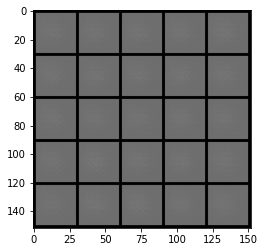

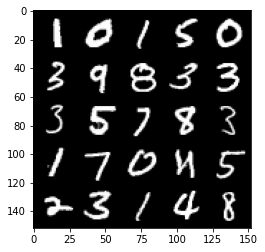

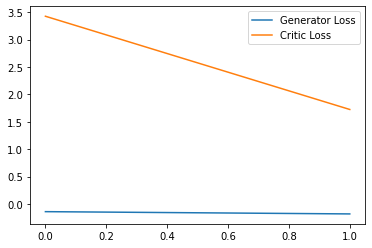

Step 100: Generator loss: 0.8545247669517994, critic loss: -1.8642550994157794


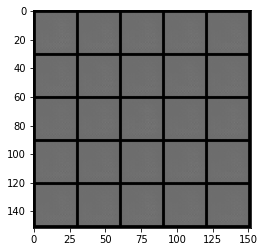

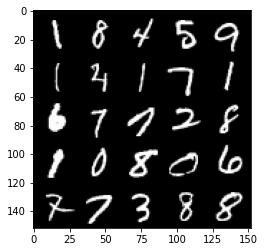

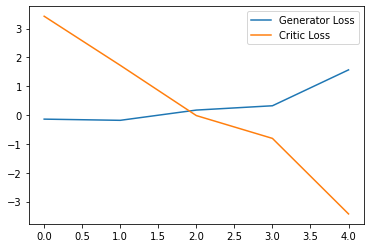

Step 150: Generator loss: 1.9472932422161102, critic loss: -10.58632937812805


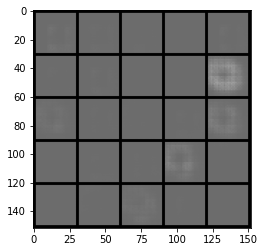

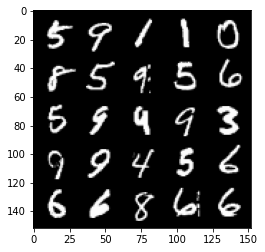

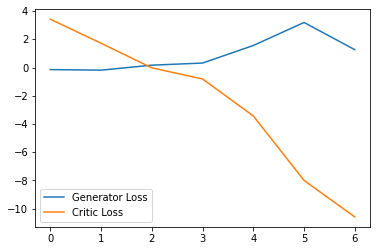

Step 200: Generator loss: -0.13719570502638817, critic loss: -27.912152046203616


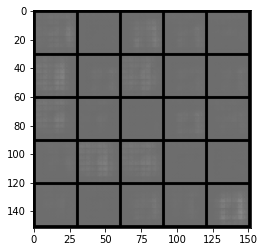

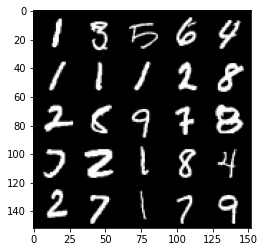

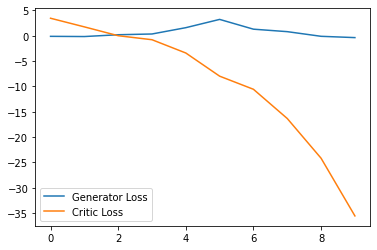

Step 250: Generator loss: -0.8042296385765075, critic loss: -60.44437686157228


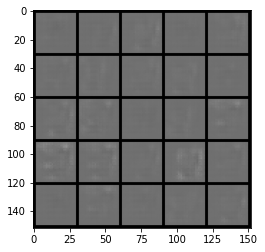

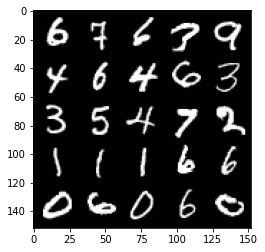

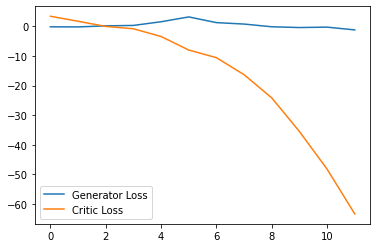

Step 300: Generator loss: 1.5812409675121308, critic loss: -105.16301704406739


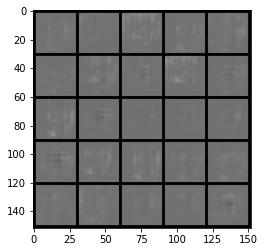

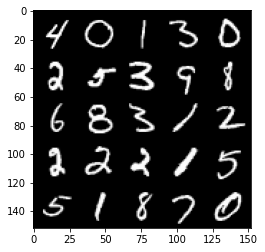

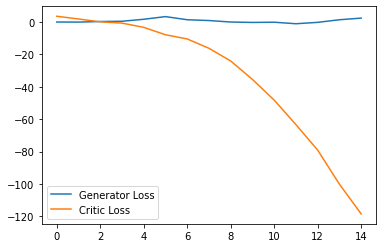

Step 350: Generator loss: 4.2828313255310055, critic loss: -153.14844628906255


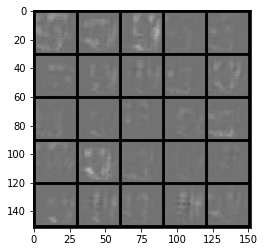

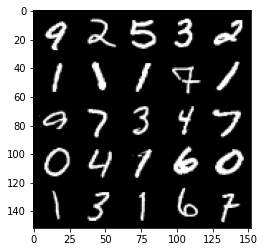

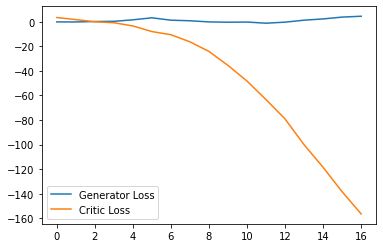

Step 400: Generator loss: 5.8046999311447145, critic loss: -207.09926971435544


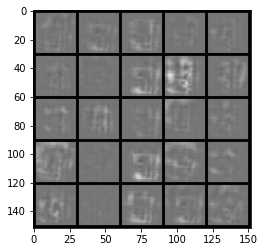

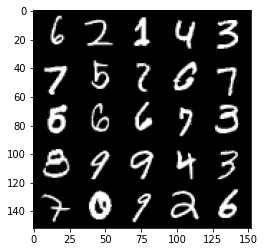

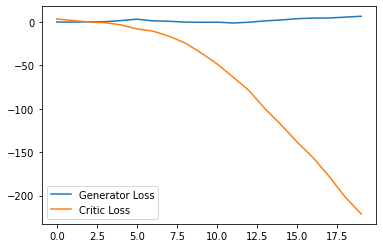

Step 450: Generator loss: 8.474330835342407, critic loss: -261.63052038574216


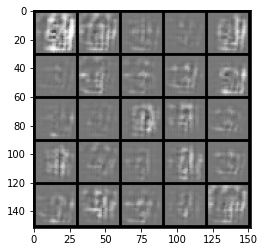

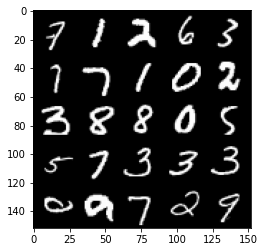

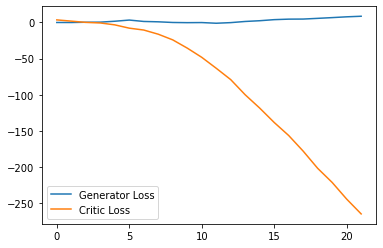

Step 500: Generator loss: -12.042603224515915, critic loss: -231.95887625122066


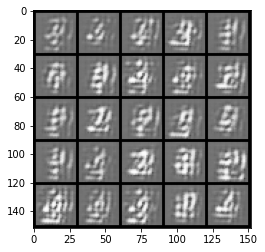

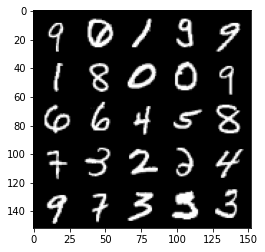

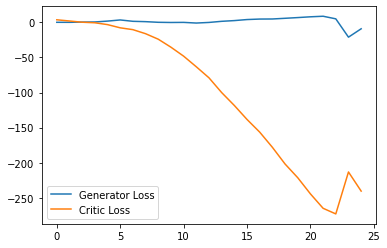

Step 550: Generator loss: -18.866453360319138, critic loss: -212.79931814575193


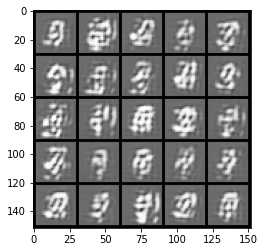

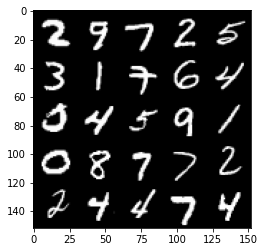

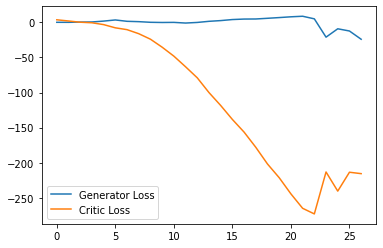

Step 600: Generator loss: 8.633813712596893, critic loss: -293.61925888061523


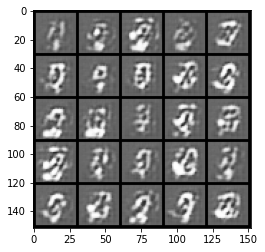

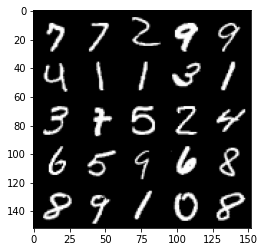

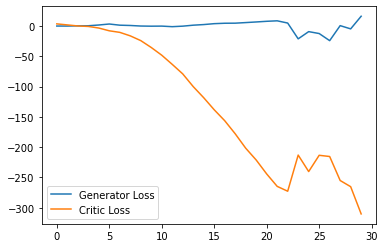

Step 650: Generator loss: 11.857334285974503, critic loss: -312.4344386901855


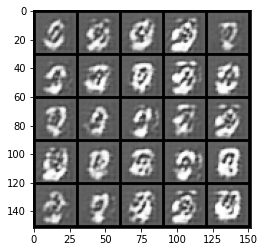

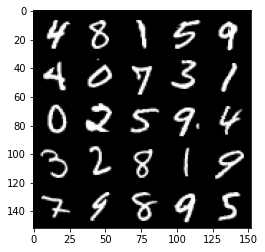

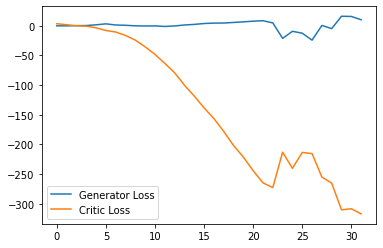

Step 700: Generator loss: -25.483360500931738, critic loss: -232.0756842651367


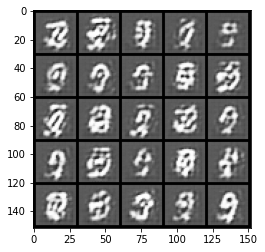

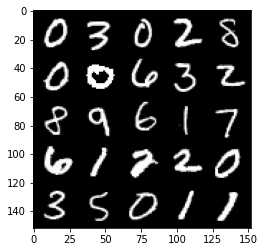

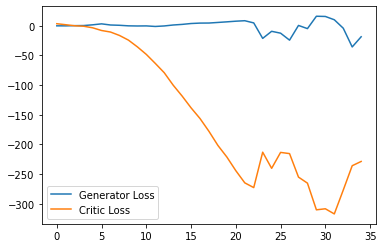

Step 750: Generator loss: -2.372700746059418, critic loss: -263.47116244506833


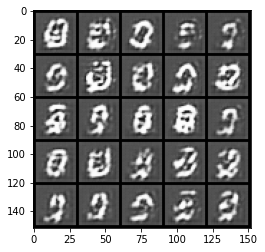

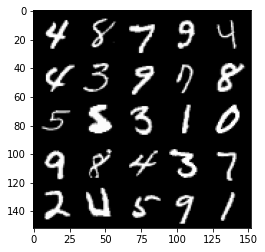

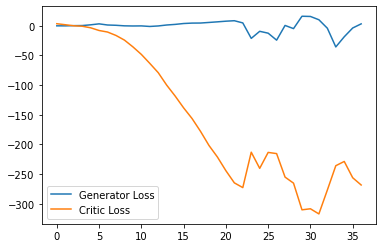

Step 800: Generator loss: -10.279282069206237, critic loss: -258.43073889160166


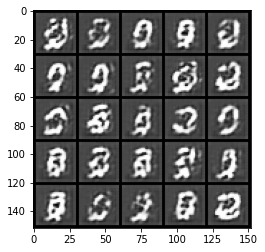

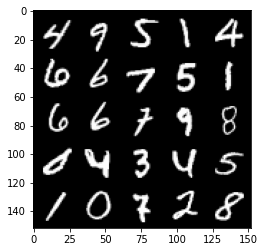

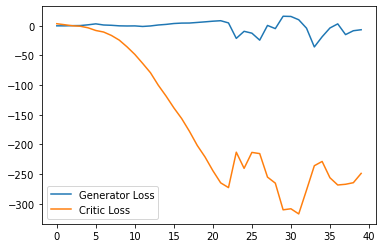

Step 850: Generator loss: -28.130215330123903, critic loss: -123.59147821807863


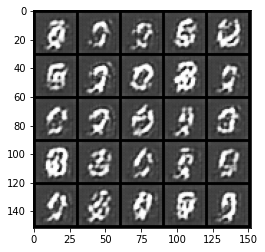

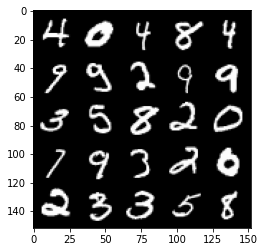

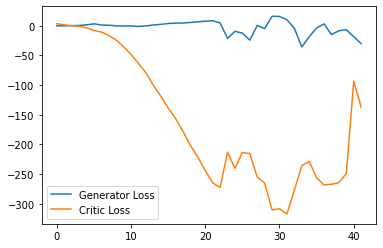

Step 900: Generator loss: -46.77225262761116, critic loss: -156.31166334533694


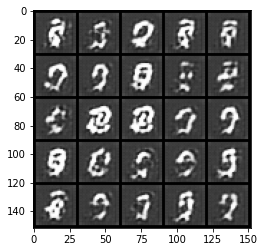

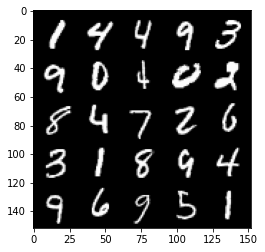

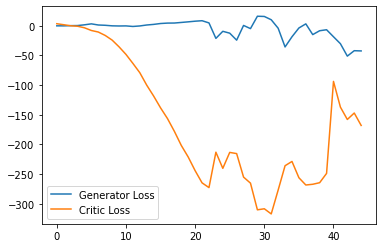

Step 950: Generator loss: -35.34919117450714, critic loss: -98.69984245300293


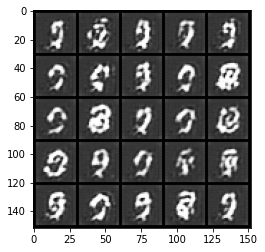

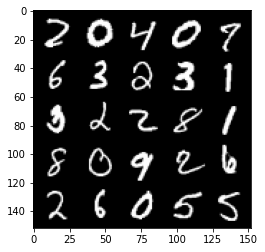

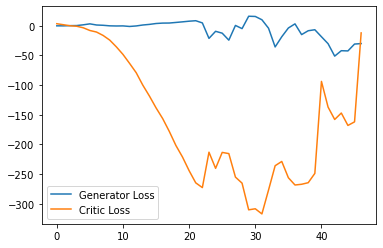

Step 1000: Generator loss: -49.98320305109024, critic loss: -74.44893442916867


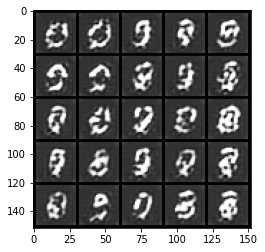

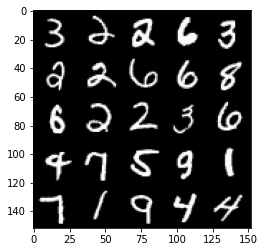

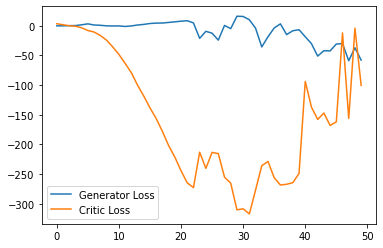

Step 1050: Generator loss: -49.602572379112246, critic loss: -110.45961987304689


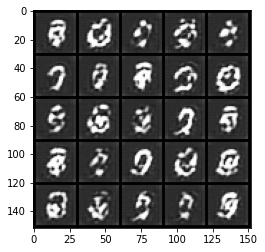

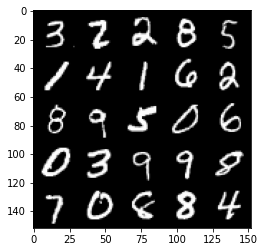

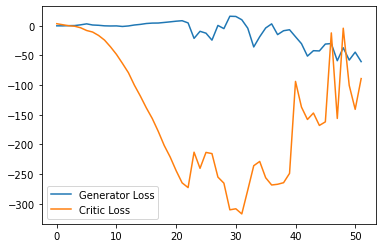

Step 1100: Generator loss: -26.070401543974878, critic loss: -49.23046714019776


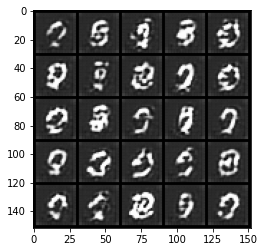

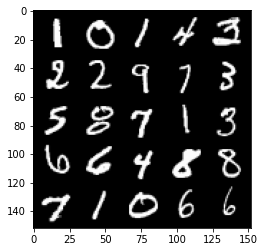

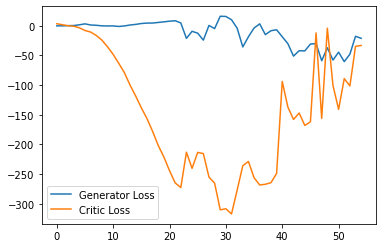

Step 1150: Generator loss: -5.146584882736206, critic loss: -3.8443569946289027


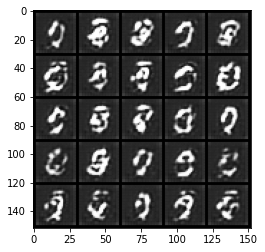

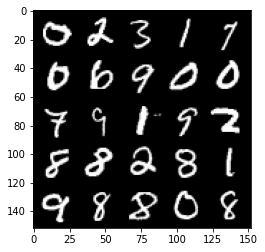

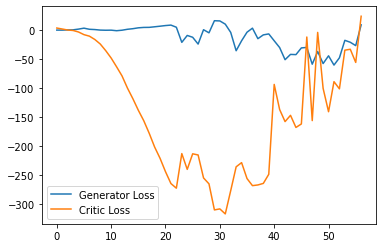

Step 1200: Generator loss: 4.635754947662353, critic loss: 35.249037662506105


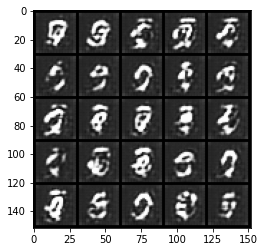

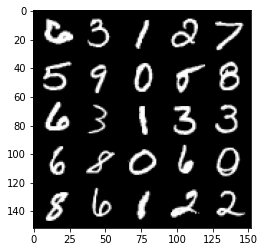

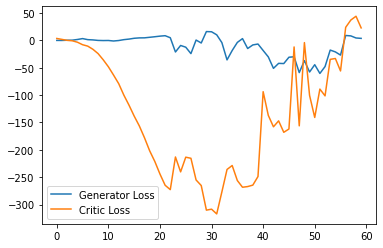

Step 1250: Generator loss: 2.9853899335861205, critic loss: 13.9202182559967


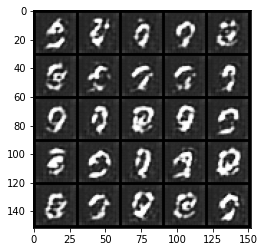

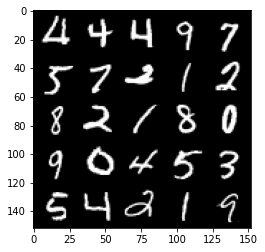

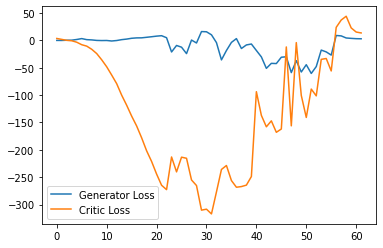

Step 1300: Generator loss: 3.471778030395508, critic loss: 9.361492076873777


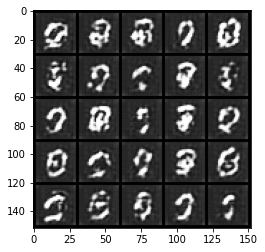

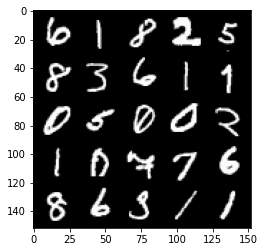

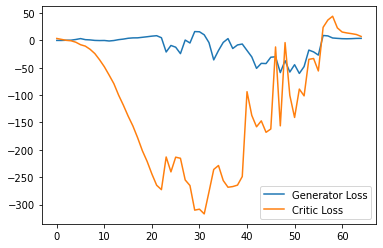

Step 1350: Generator loss: 3.316417579650879, critic loss: 4.195145835876464


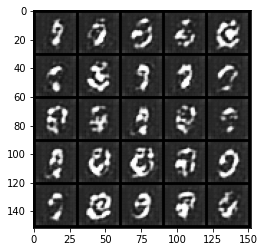

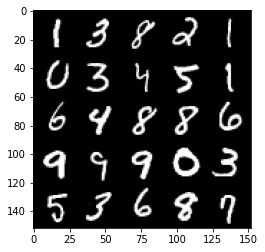

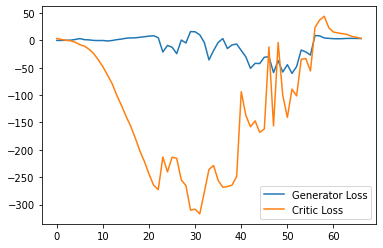

Step 1400: Generator loss: 2.3131861996650698, critic loss: 3.983729804992677


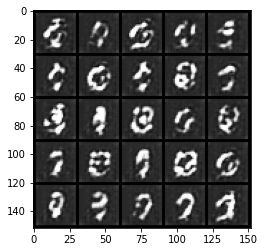

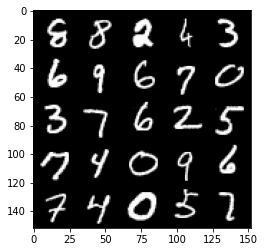

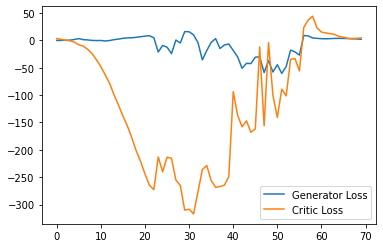

Step 1450: Generator loss: -0.07843106806278229, critic loss: 9.816983253479005


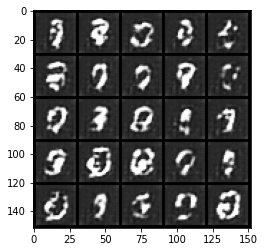

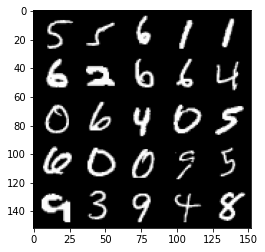

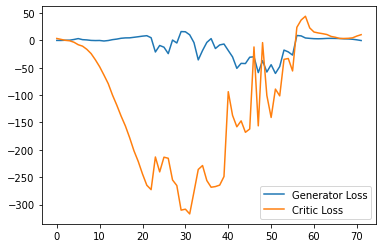

Step 1500: Generator loss: -2.946091321706772, critic loss: 12.063689132690433


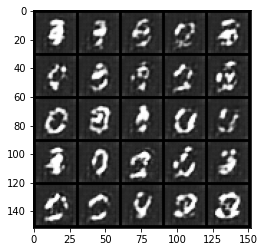

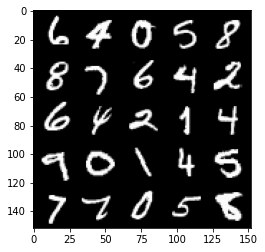

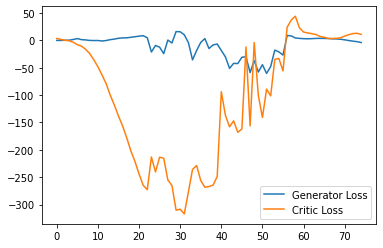

Step 1550: Generator loss: -4.930339093208313, critic loss: 9.422551368713378


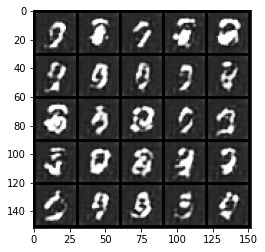

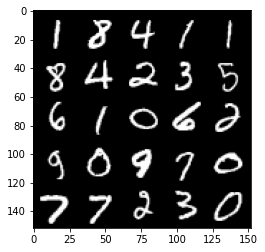

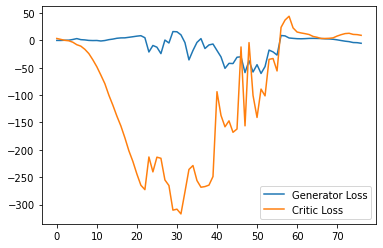

Step 1600: Generator loss: -6.442774629592895, critic loss: 5.320440326690674


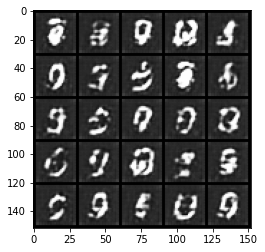

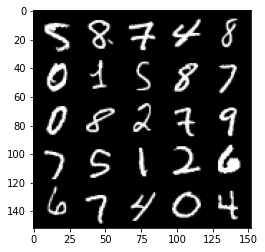

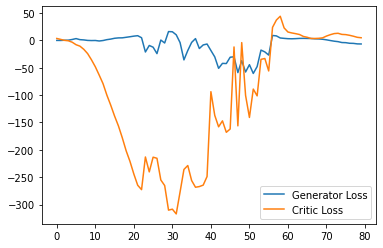

Step 1650: Generator loss: -7.269596910476684, critic loss: 0.8045528755187991


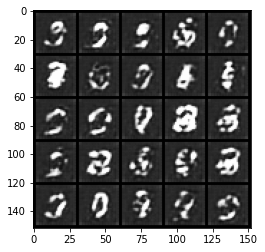

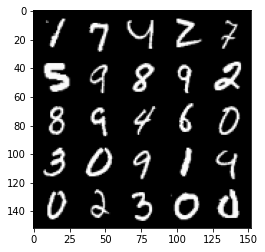

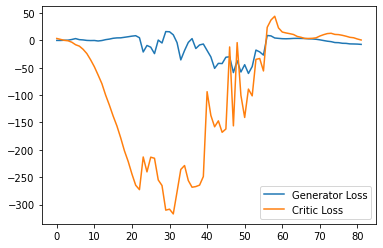

Step 1700: Generator loss: -7.740421028137207, critic loss: -4.103431869506836


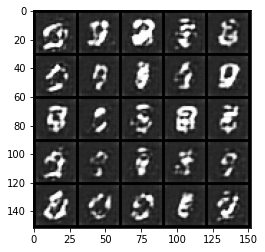

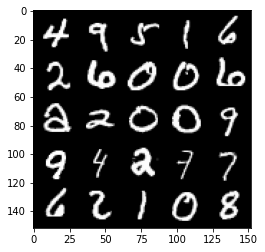

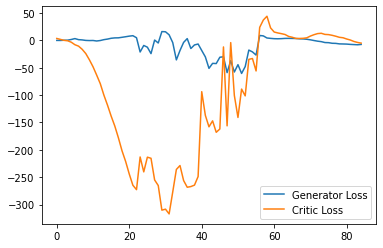

Step 1750: Generator loss: -9.304422388076782, critic loss: -8.08304886245728


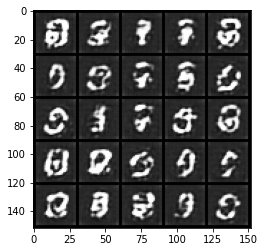

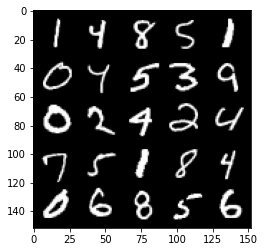

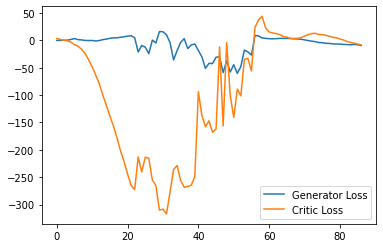

Step 1800: Generator loss: -7.8952928763628005, critic loss: -11.410883644104006


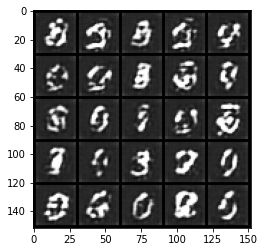

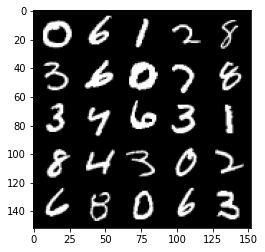

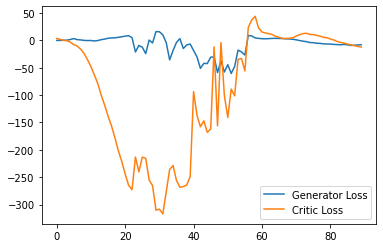

Step 1850: Generator loss: -9.255721609592438, critic loss: -14.806038433074953


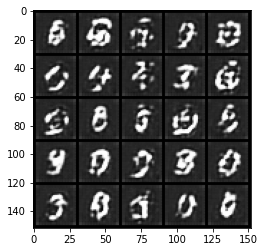

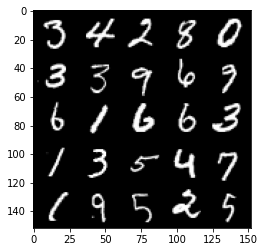

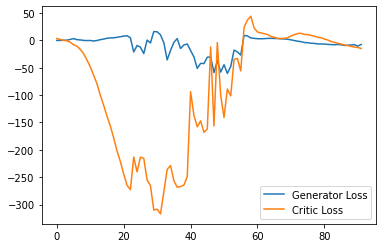

Step 1900: Generator loss: -9.721629790067674, critic loss: -17.925189491271972


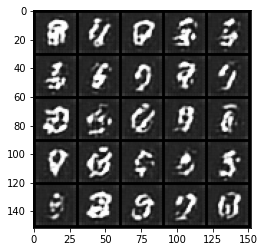

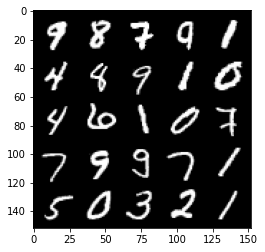

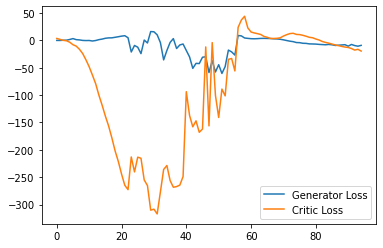

Step 1950: Generator loss: -12.681715755462646, critic loss: -10.333870948791507


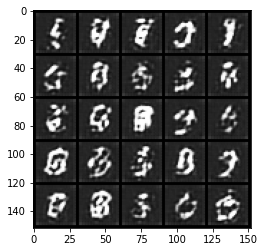

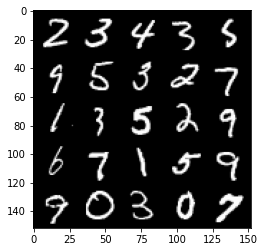

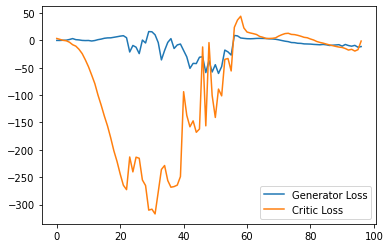

Step 2000: Generator loss: -14.541024389266967, critic loss: -18.014456489562996


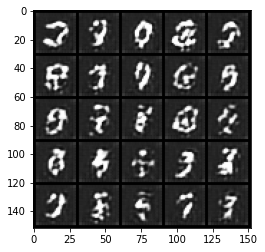

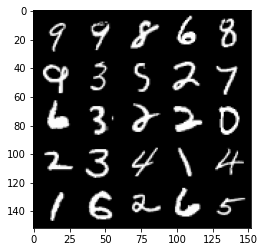

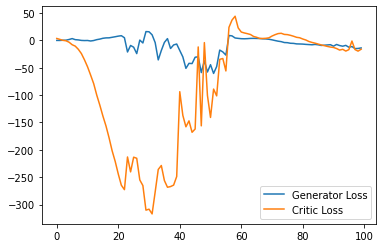

Step 2050: Generator loss: -14.98360961675644, critic loss: -19.991022457122796


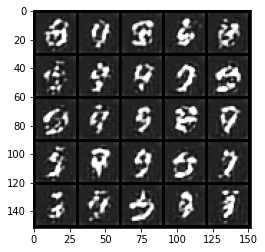

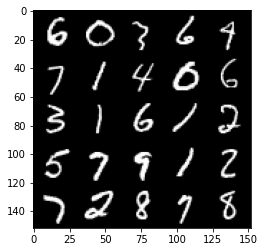

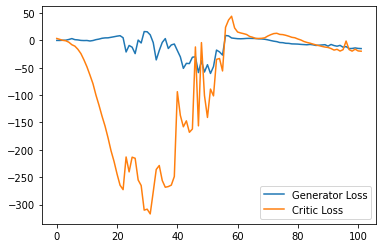

Step 2100: Generator loss: -15.108154439926148, critic loss: -21.380881965637215


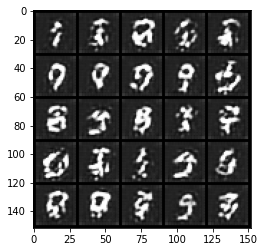

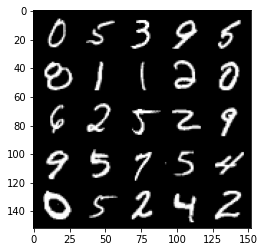

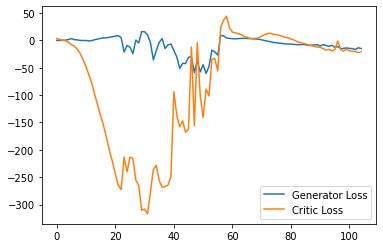

Step 2150: Generator loss: -13.656162786483765, critic loss: -23.871790737152097


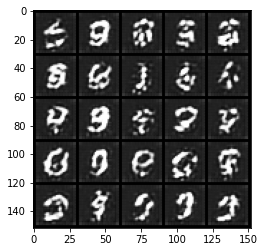

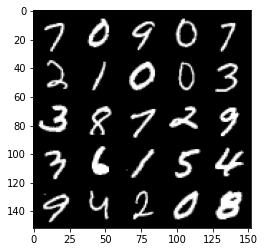

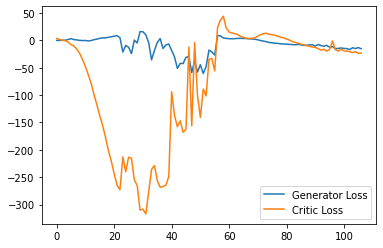

Step 2200: Generator loss: -14.876770932376385, critic loss: -24.476619384765623


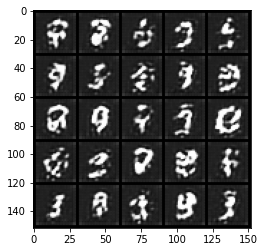

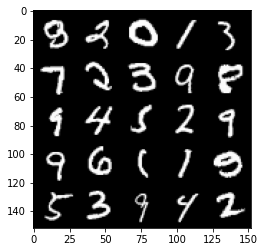

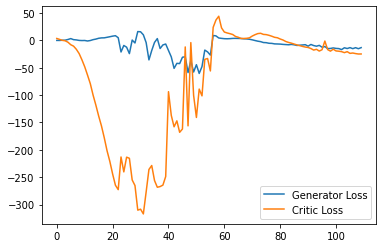

Step 2250: Generator loss: -11.933921446800232, critic loss: -18.122918105125425


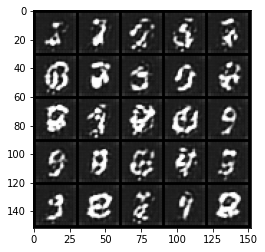

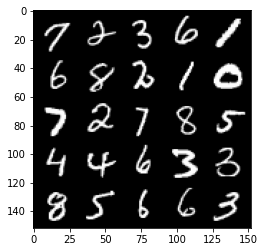

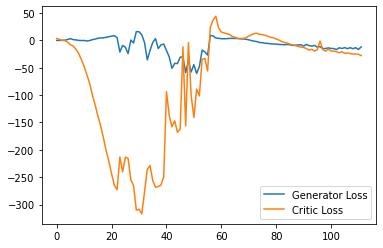

Step 2300: Generator loss: -11.719050464630127, critic loss: -5.445783339500427


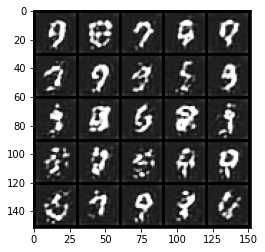

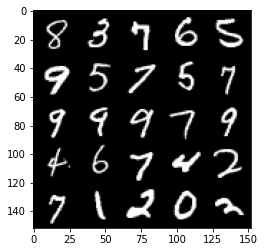

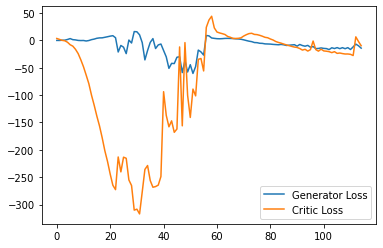

Step 2350: Generator loss: -16.3441229057312, critic loss: -23.606179788589472


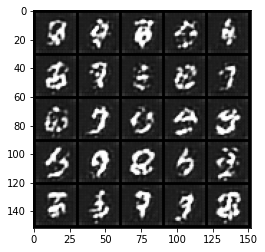

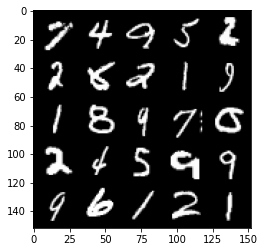

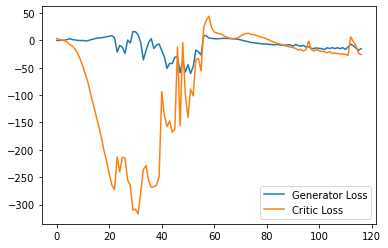

Step 2400: Generator loss: -15.721405067443847, critic loss: -24.644082717895508


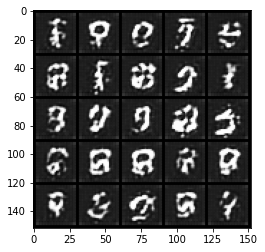

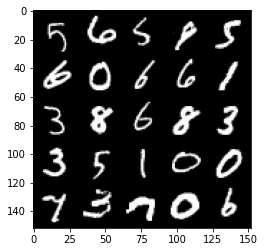

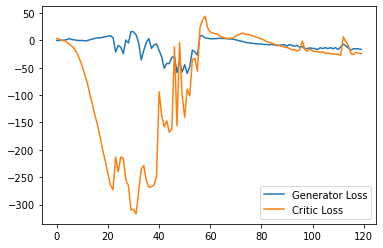

Step 2450: Generator loss: -13.737420282363892, critic loss: -11.36551379108429


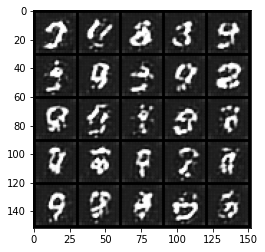

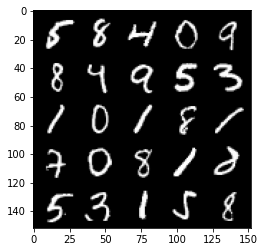

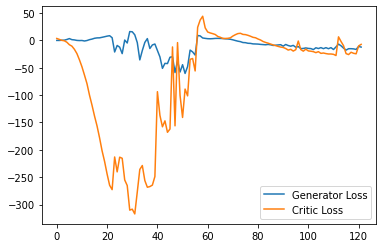

Step 2500: Generator loss: -18.197320985794068, critic loss: -17.87826375389099


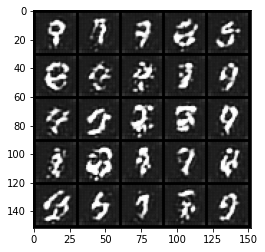

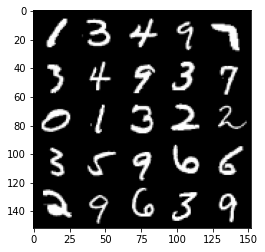

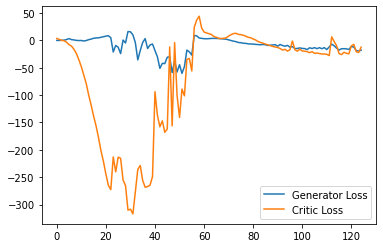

Step 2550: Generator loss: -20.049270095825197, critic loss: -23.284387331008908


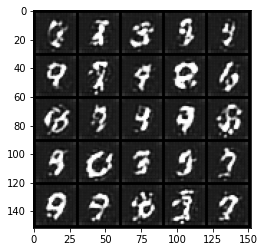

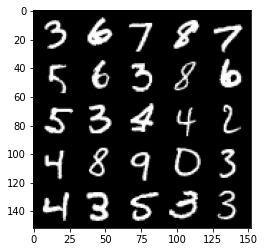

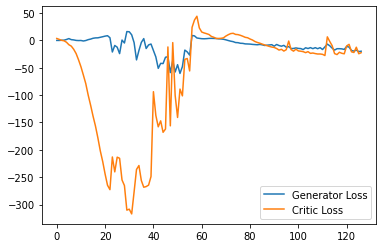

Step 2600: Generator loss: -21.309986552000044, critic loss: -24.202889276504514


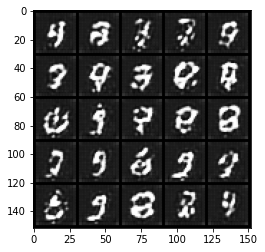

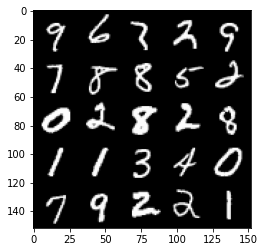

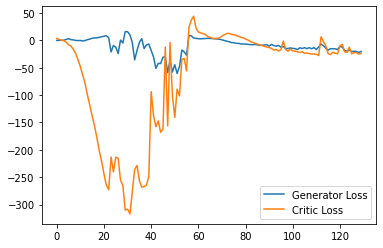

Step 2650: Generator loss: -17.418183939158915, critic loss: -19.831240415573117


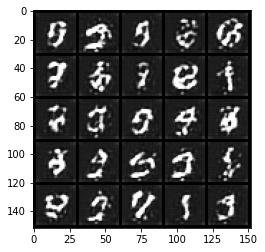

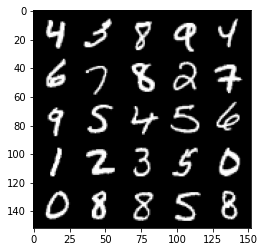

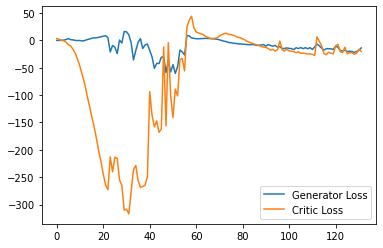

Step 2700: Generator loss: -20.400646352767943, critic loss: -21.503229757308958


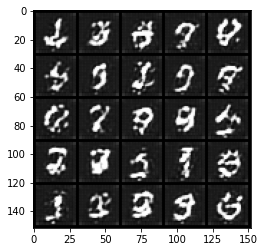

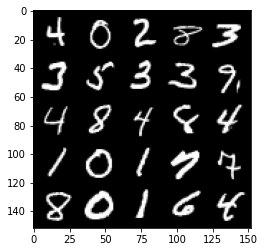

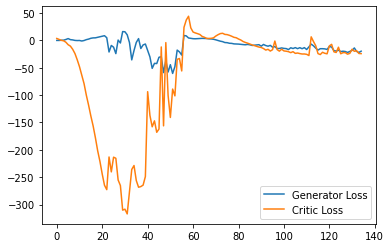

Step 2750: Generator loss: -22.04223883628845, critic loss: -25.16018804740906


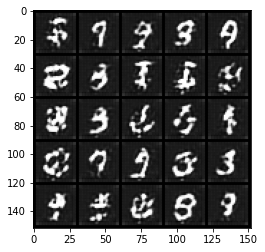

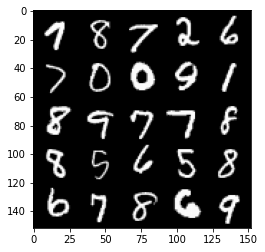

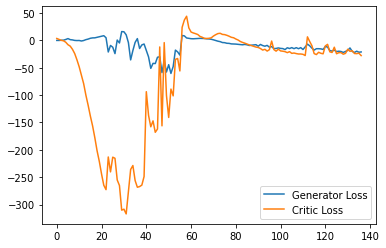

Step 2800: Generator loss: -17.479783906936646, critic loss: -16.934643577575685


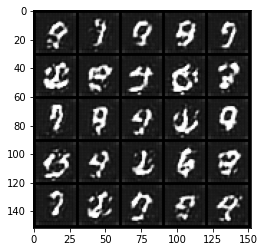

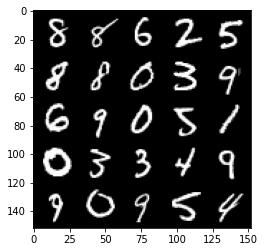

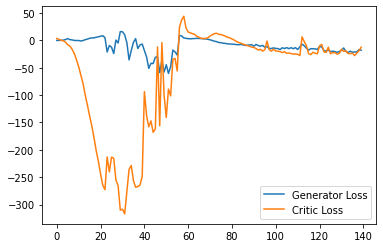

Step 2850: Generator loss: -22.42747254371643, critic loss: -23.29330282783508


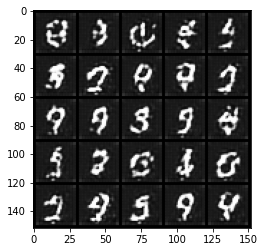

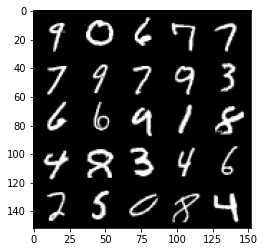

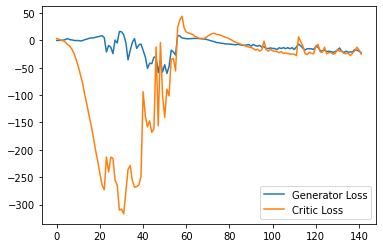

Step 2900: Generator loss: -20.977351455688478, critic loss: -19.2455682258606


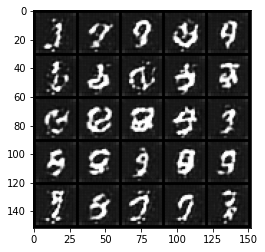

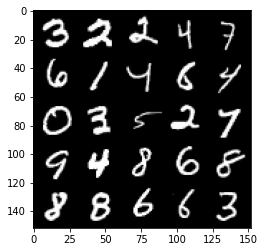

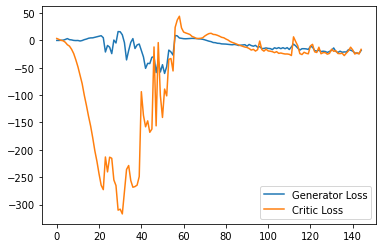

Step 2950: Generator loss: -14.05271104812622, critic loss: -2.3126274499893182


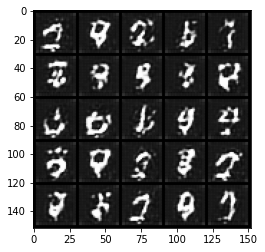

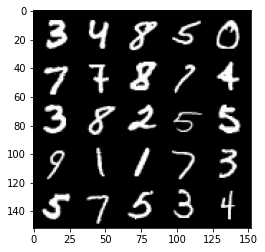

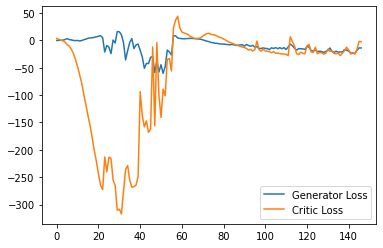

Step 3000: Generator loss: -20.887790622711183, critic loss: -10.717451297760011


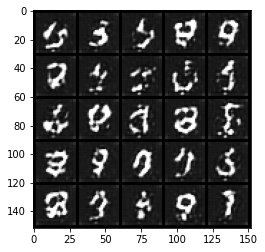

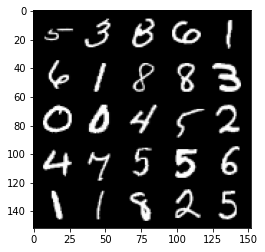

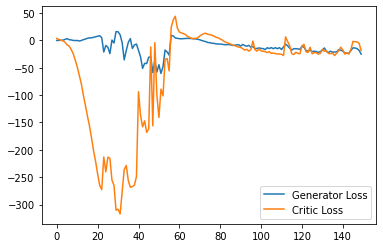

Step 3050: Generator loss: -26.170259494781494, critic loss: -19.48601835727692


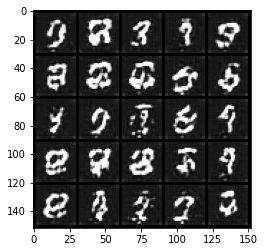

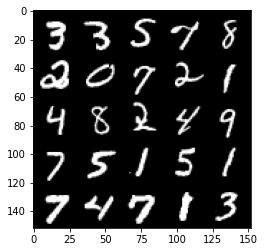

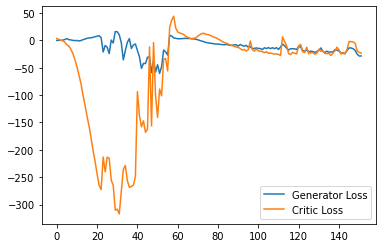

Step 3100: Generator loss: -27.16054485321045, critic loss: -24.128172924995418


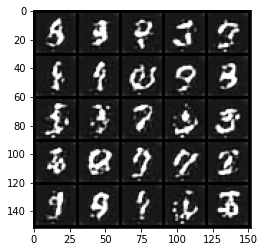

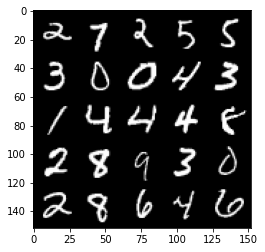

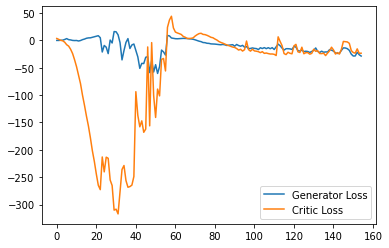

Step 3150: Generator loss: -25.103341302871705, critic loss: -23.791269905090346


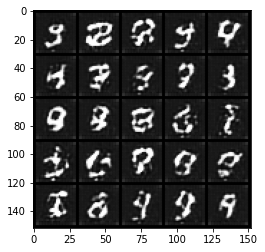

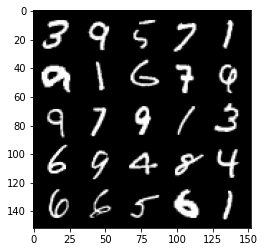

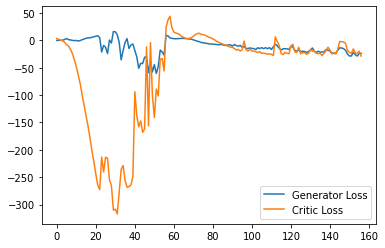

Step 3200: Generator loss: -24.514020195007323, critic loss: -19.484334115028375


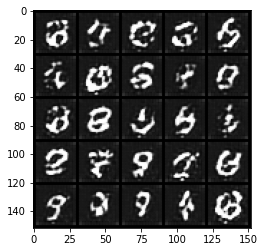

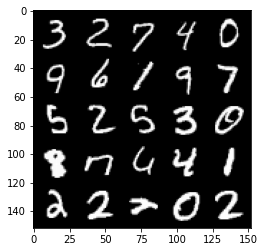

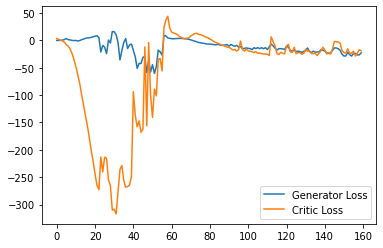

Step 3250: Generator loss: -25.700176076889036, critic loss: -21.396546716690064


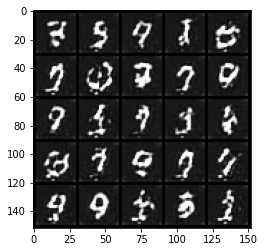

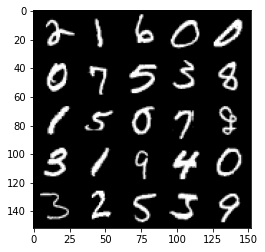

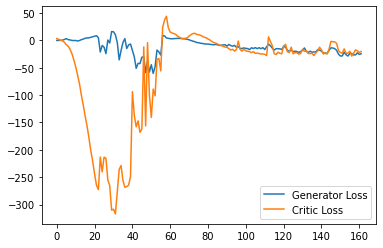

Step 3300: Generator loss: -26.629675769805907, critic loss: -25.289740090370177


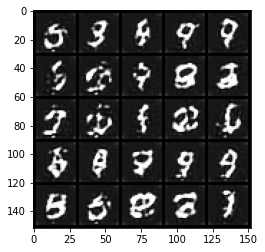

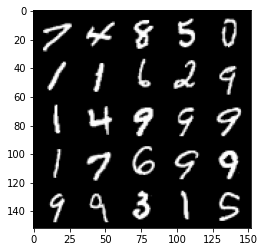

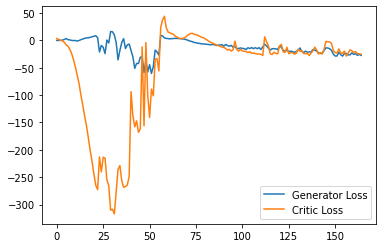

Step 3350: Generator loss: -19.382139678001405, critic loss: -5.427438725948333


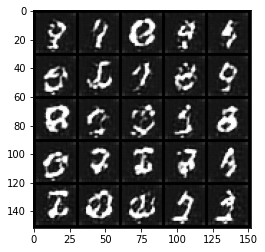

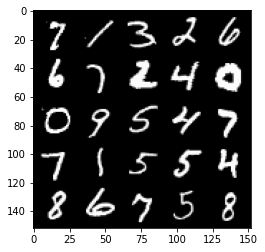

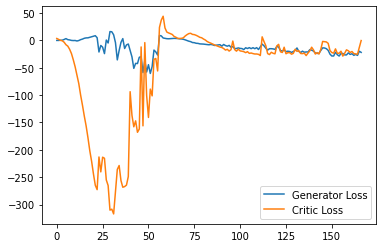

Step 3400: Generator loss: -17.00711067199707, critic loss: -2.5844702329635623


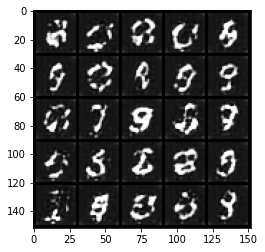

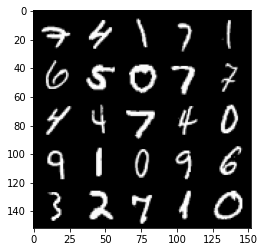

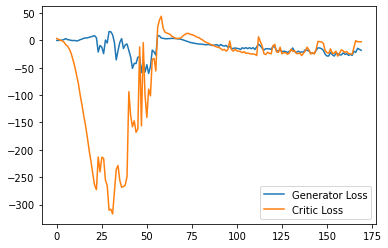

Step 3450: Generator loss: -20.835748558044433, critic loss: -3.282074249744415


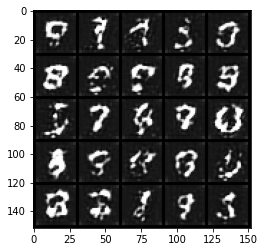

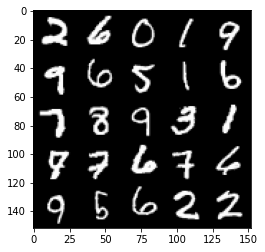

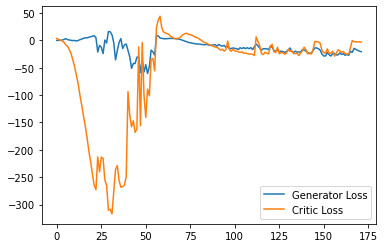

Step 3500: Generator loss: -29.35372386932373, critic loss: -19.456448581695557


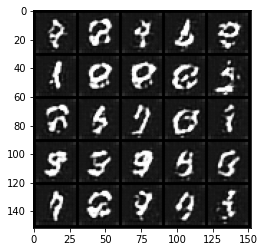

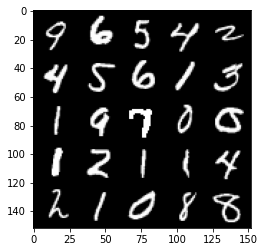

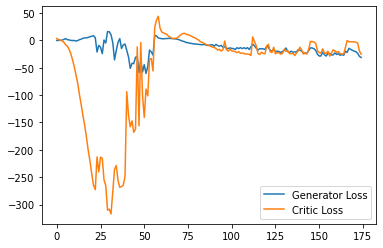

Step 3550: Generator loss: -24.59131184577942, critic loss: -19.99473981571197


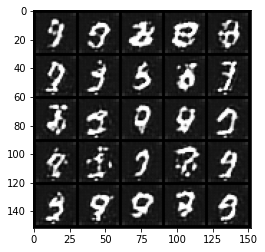

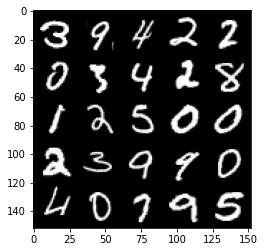

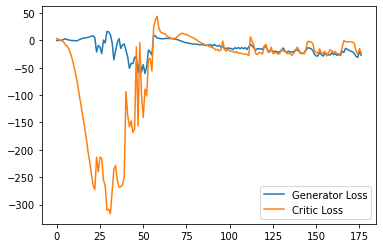

Step 3600: Generator loss: -27.759869270324707, critic loss: -24.031773415565496


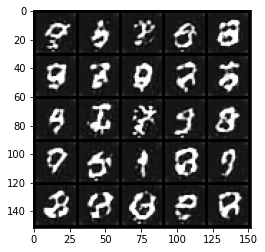

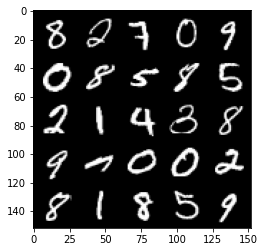

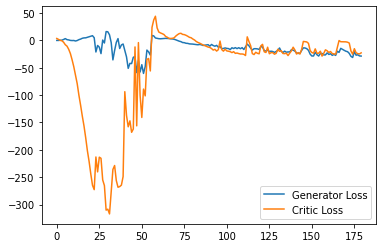

Step 3650: Generator loss: -25.099904130101205, critic loss: -20.228852834701534


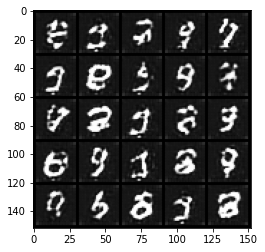

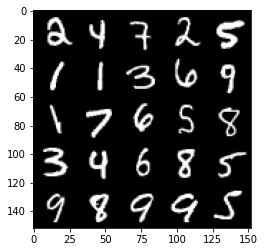

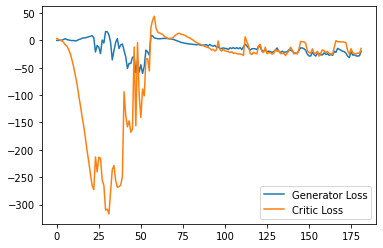

Step 3700: Generator loss: -21.471486434936523, critic loss: -15.867096173286436


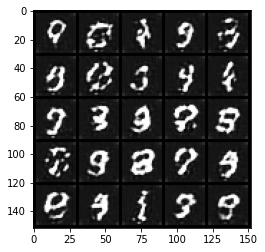

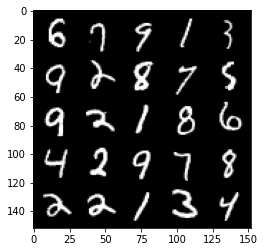

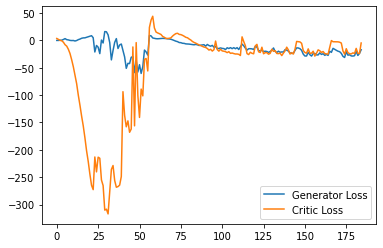

Step 3750: Generator loss: -24.930689640045166, critic loss: -17.68345639801026


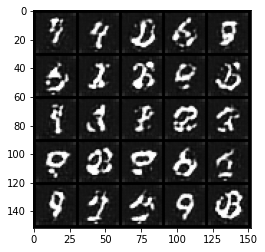

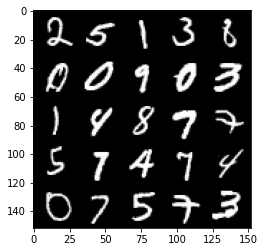

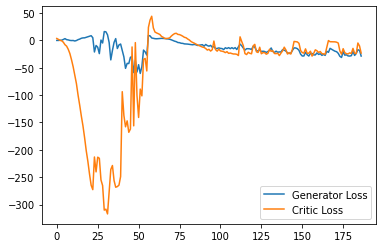

Step 3800: Generator loss: -23.82992430448532, critic loss: -20.40019170999526


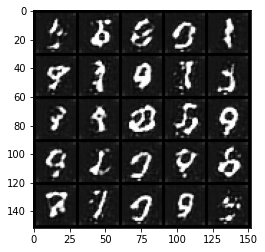

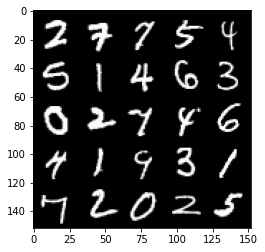

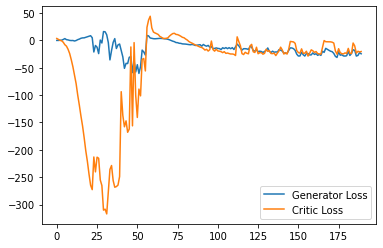

Step 3850: Generator loss: -24.860804772377016, critic loss: -21.816246062278747


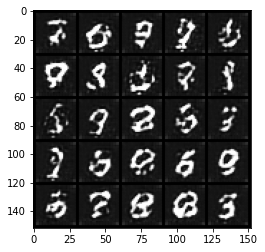

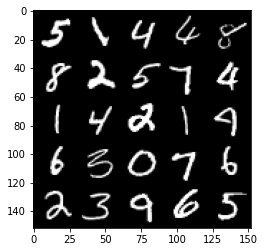

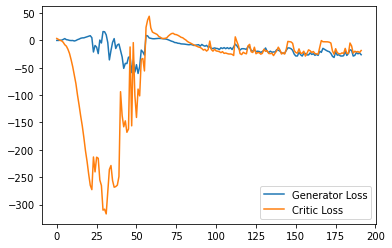

Step 3900: Generator loss: -23.198357640504838, critic loss: -20.456512440681454


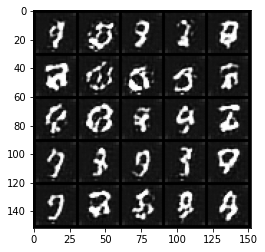

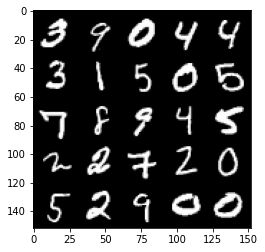

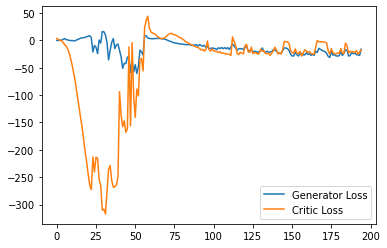

Step 3950: Generator loss: -22.38353717327118, critic loss: -15.216336369514464


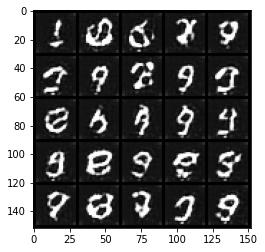

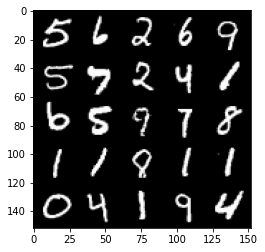

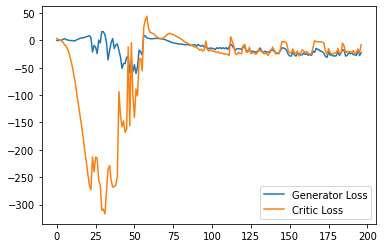

Step 4000: Generator loss: -27.68420166015625, critic loss: -22.302558137893676


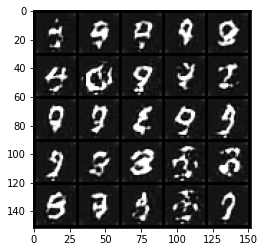

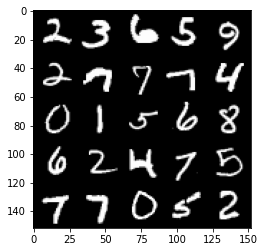

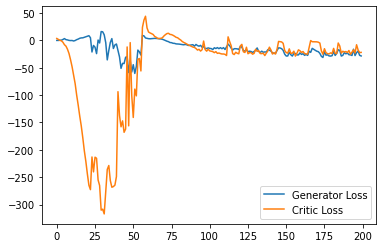

Step 4050: Generator loss: -25.22344970703125, critic loss: -19.799814943313603


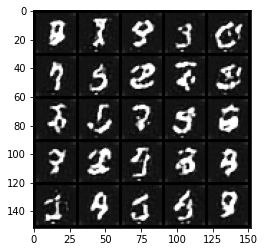

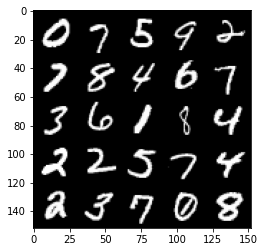

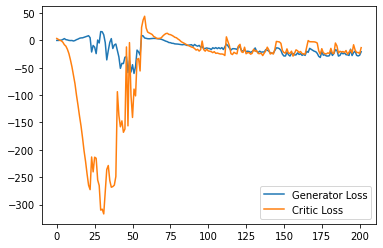

Step 4100: Generator loss: -13.52138921737671, critic loss: 7.0925657038688685


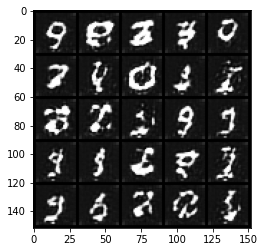

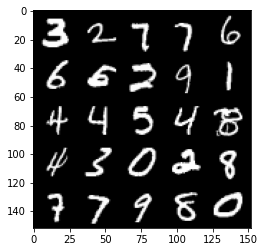

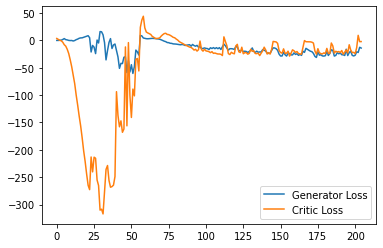

Step 4150: Generator loss: -17.9939986038208, critic loss: -2.168008316993713


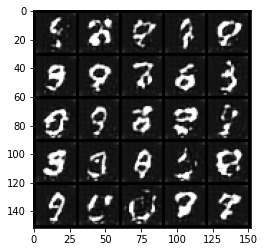

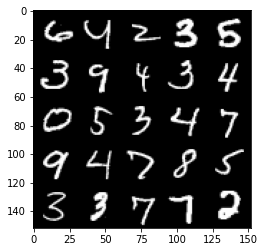

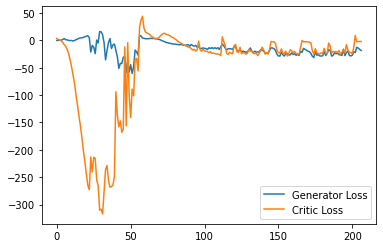

Step 4200: Generator loss: -20.243721466064454, critic loss: -2.483456207752228


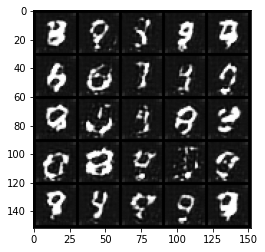

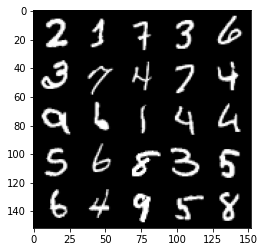

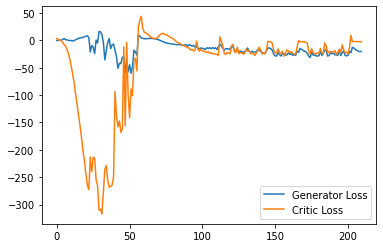

Step 4250: Generator loss: -20.451260414123535, critic loss: -2.780419164657593


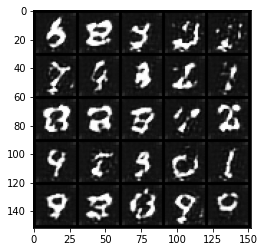

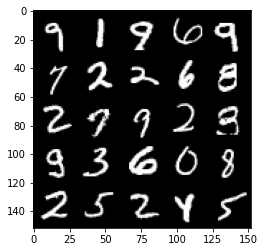

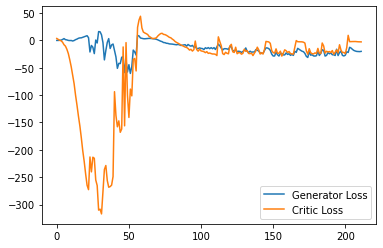

Step 4300: Generator loss: -20.70547409057617, critic loss: -2.962389863014221


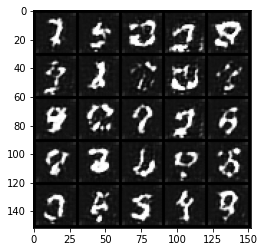

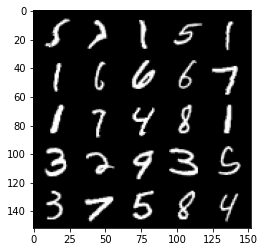

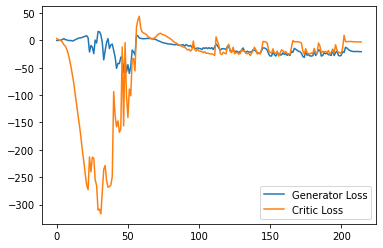

Step 4350: Generator loss: -21.415701026916505, critic loss: -3.248800988197326


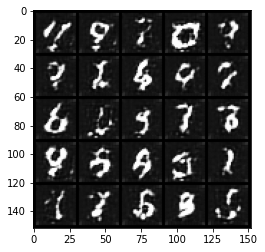

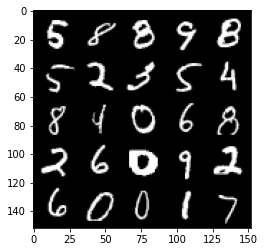

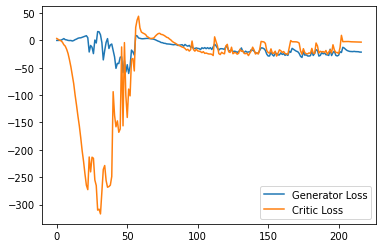

Step 4400: Generator loss: -21.207941474914552, critic loss: -3.6888715953826896


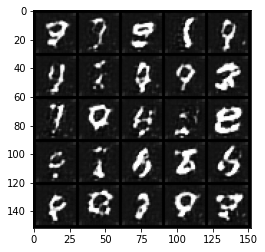

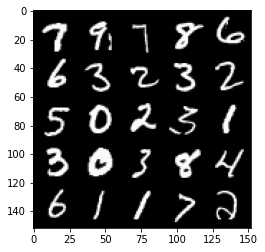

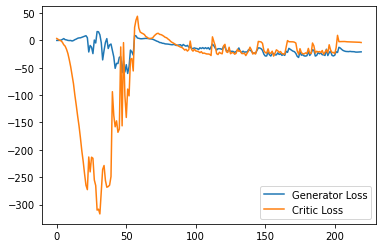

Step 4450: Generator loss: -20.586591911315917, critic loss: -0.2164564123153691


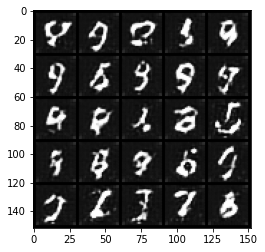

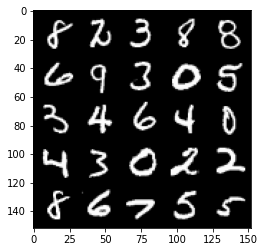

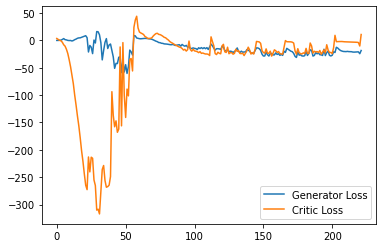

Step 4500: Generator loss: -17.96513671875, critic loss: -2.352345415115357


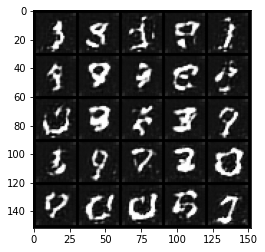

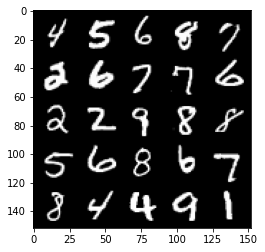

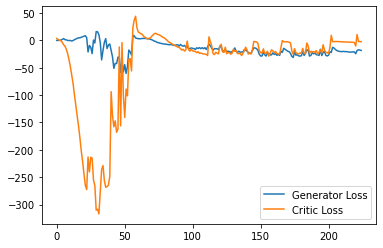

Step 4550: Generator loss: -19.318117485046386, critic loss: -2.6670317411422735


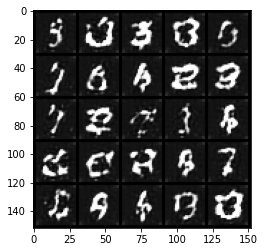

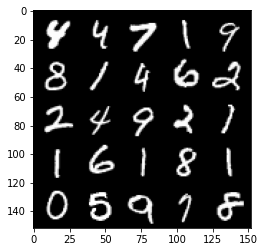

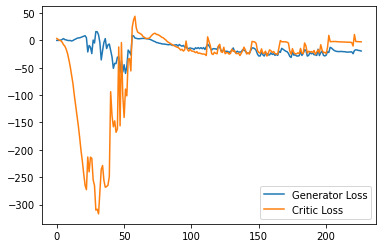

Step 4600: Generator loss: -20.076315116882324, critic loss: -3.0606417837142947


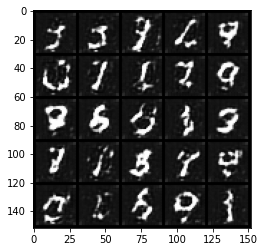

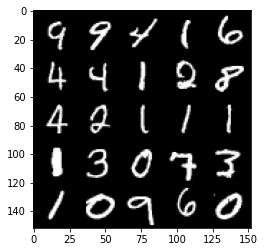

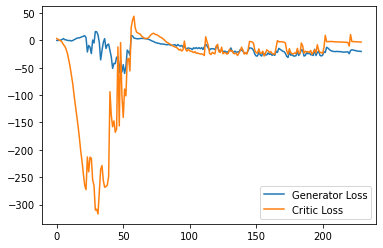

Step 4650: Generator loss: -20.25186653137207, critic loss: -3.453063443183899


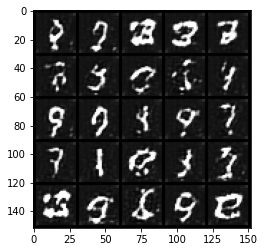

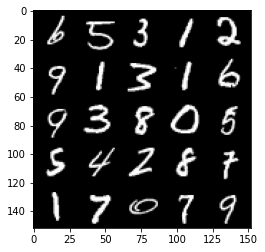

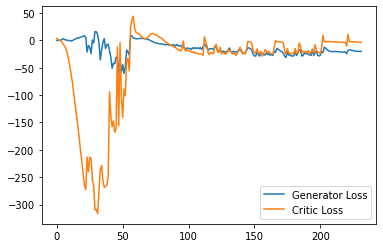

Step 4700: Generator loss: -22.2621252822876, critic loss: -5.283464581489563


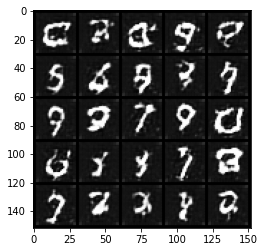

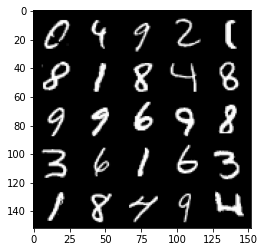

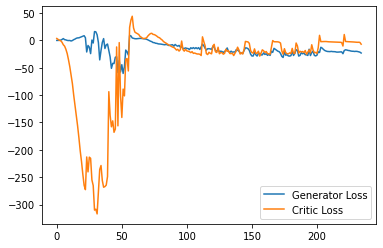

Step 4750: Generator loss: -27.78523313522339, critic loss: -20.060184383392336


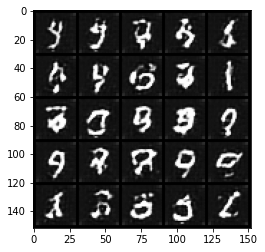

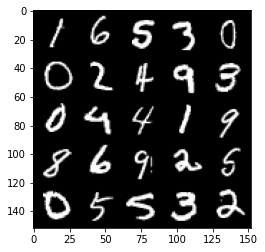

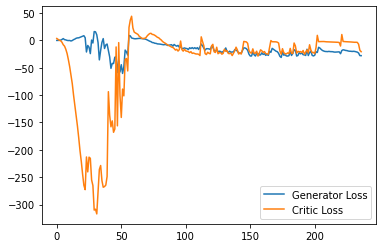

Step 4800: Generator loss: -16.907990369796753, critic loss: -2.576864163398743


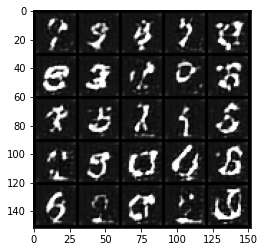

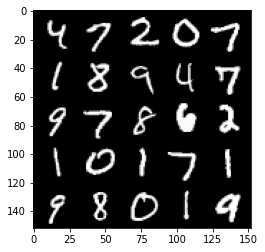

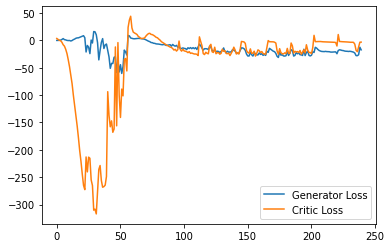

Step 4850: Generator loss: -23.447860145568846, critic loss: -14.819418384551998


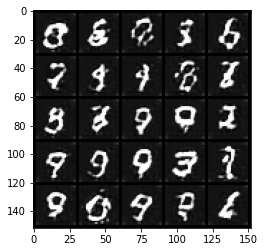

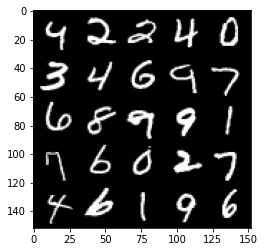

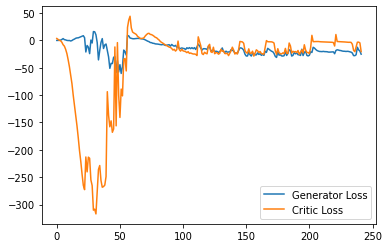

Step 4900: Generator loss: -20.945655155181885, critic loss: -16.703675196647644


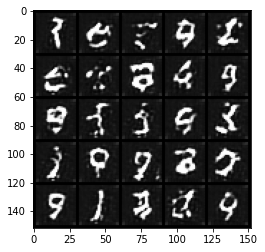

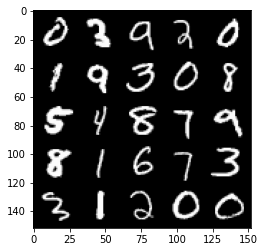

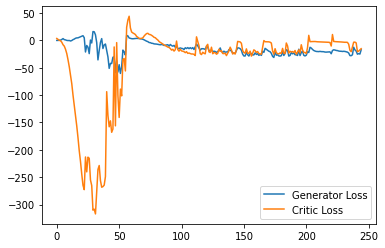

Step 4950: Generator loss: -22.561218786239625, critic loss: -19.267140188217166


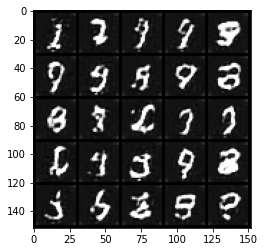

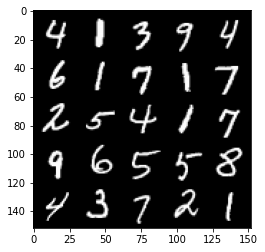

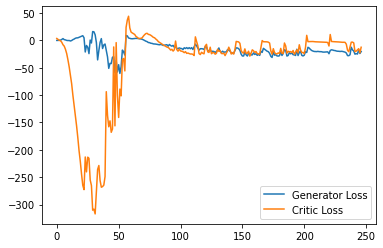

Step 5000: Generator loss: -24.457025470733644, critic loss: -20.835909057617187


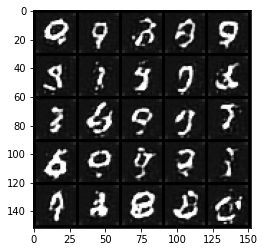

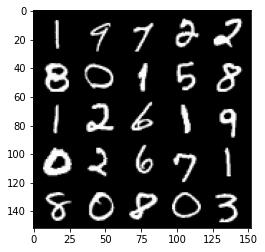

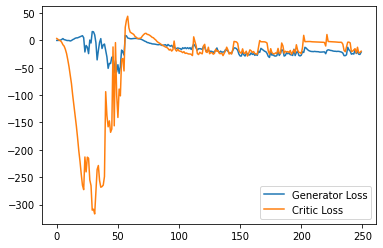

Step 5050: Generator loss: -11.989025344848633, critic loss: -2.019309785366058


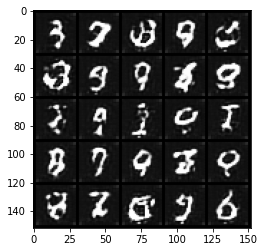

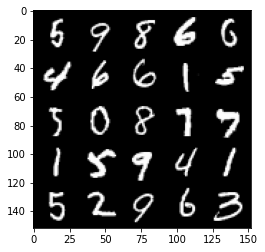

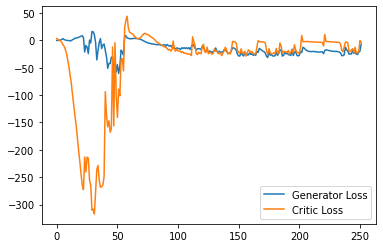

Step 5100: Generator loss: -12.7595853805542, critic loss: -3.9632225232124334


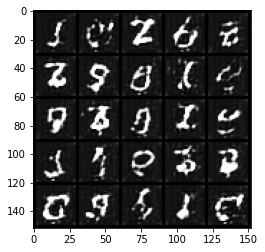

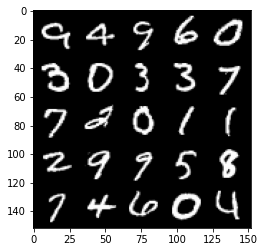

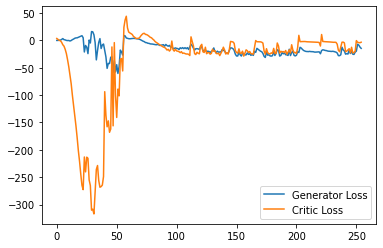

Step 5150: Generator loss: -21.150346202850344, critic loss: -14.690480679512023


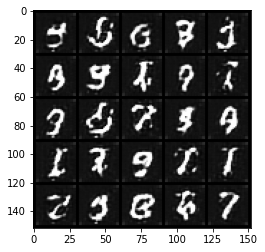

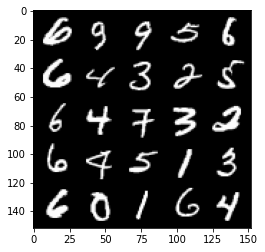

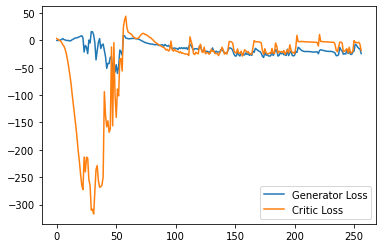

Step 5200: Generator loss: -21.557869205474855, critic loss: -21.124103138923648


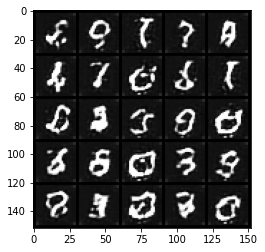

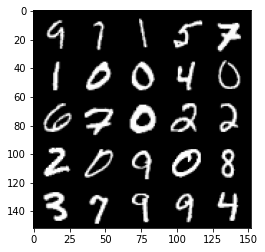

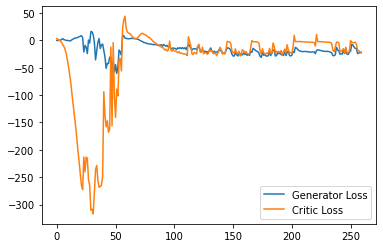

Step 5250: Generator loss: -20.946400728225708, critic loss: -21.330104444503785


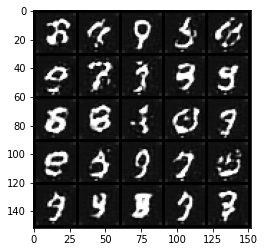

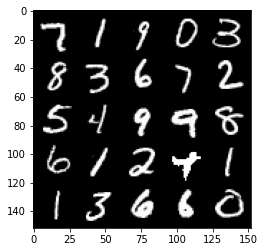

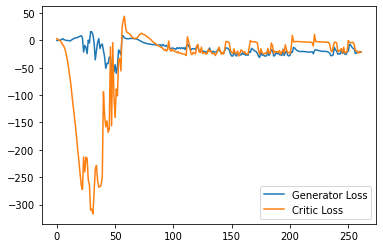

Step 5300: Generator loss: -15.590418027043343, critic loss: -17.900159142017365


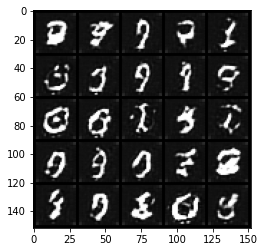

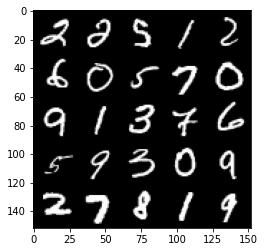

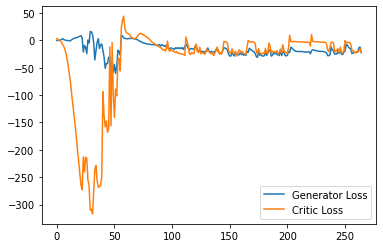

Step 5350: Generator loss: -15.74383489832282, critic loss: -20.555474645614623


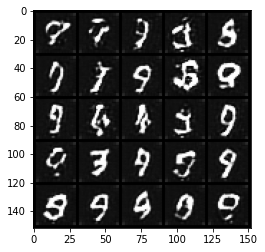

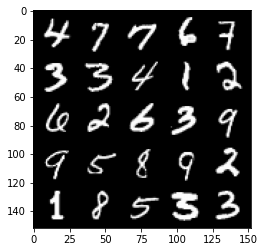

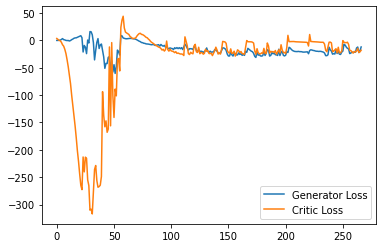

Step 5400: Generator loss: -18.66736375927925, critic loss: -20.21004036092758


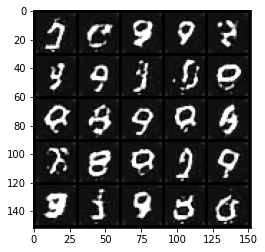

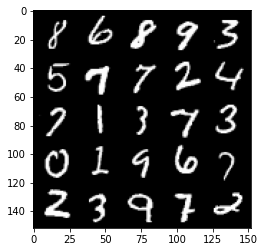

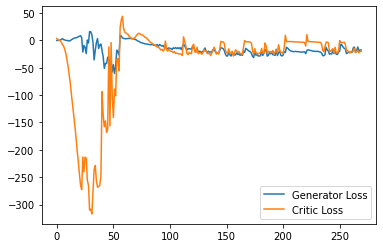

Step 5450: Generator loss: -5.381375054121017, critic loss: -1.4548450684547418


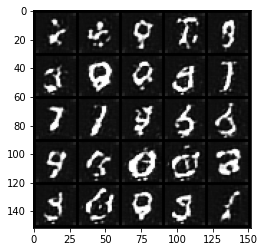

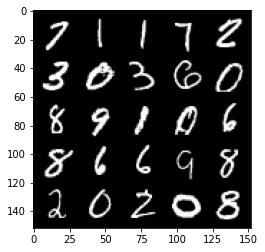

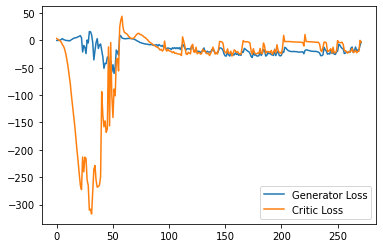

Step 5500: Generator loss: -6.85401273727417, critic loss: -3.1944207754135134


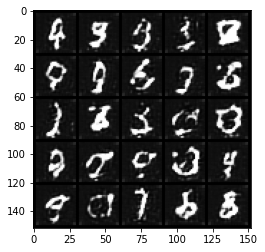

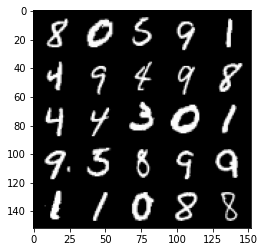

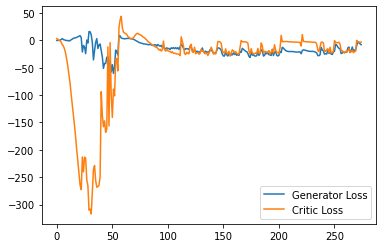

Step 5550: Generator loss: -10.568934993743897, critic loss: -4.4445947189331045


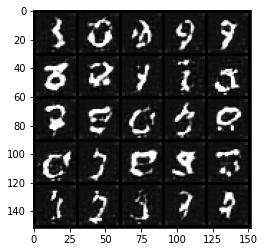

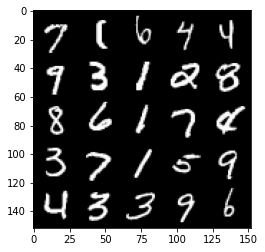

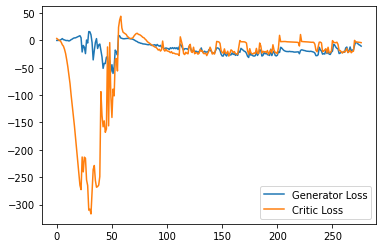

Step 5600: Generator loss: -17.048675395846367, critic loss: -20.071178654670717


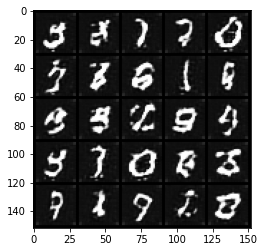

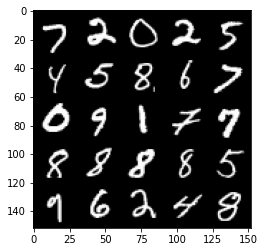

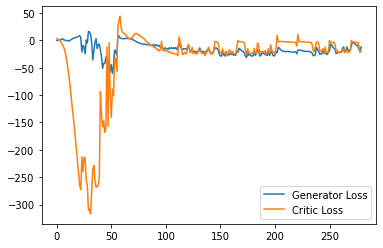

Step 5650: Generator loss: -10.471960306167603, critic loss: -2.923125349044801


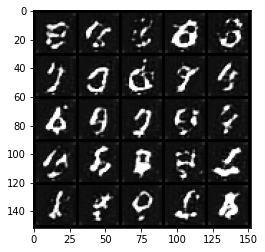

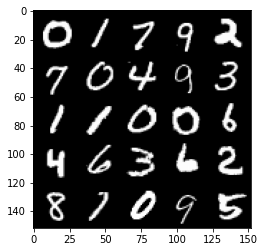

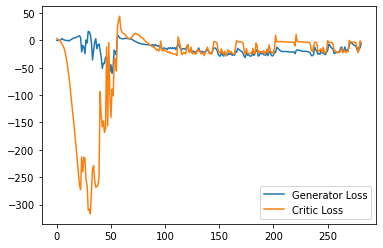

Step 5700: Generator loss: -19.221107219457625, critic loss: -19.362621673107142


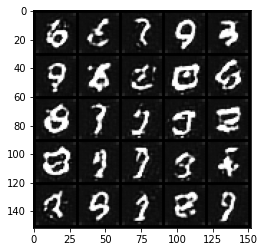

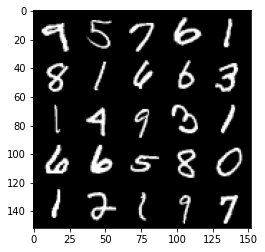

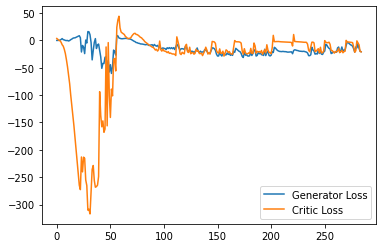

Step 5750: Generator loss: -16.9156852722168, critic loss: -19.237161913871766


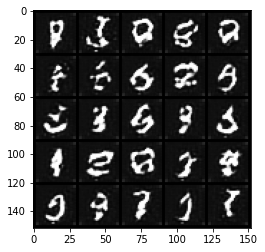

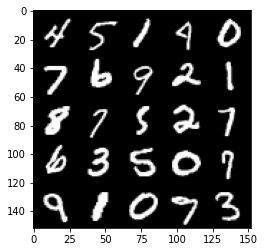

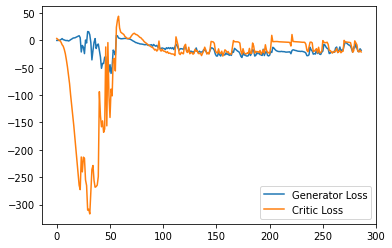

Step 5800: Generator loss: -16.38934419155121, critic loss: -23.14072301101685


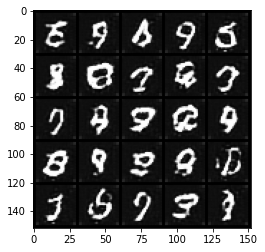

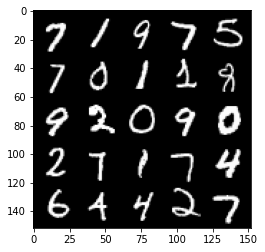

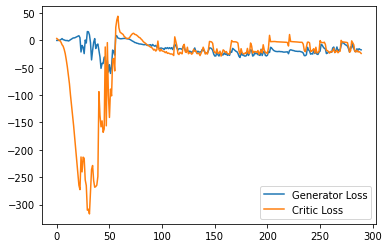

Step 5850: Generator loss: -12.443563599586486, critic loss: -19.763506227493284


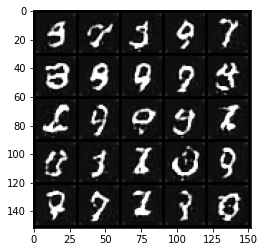

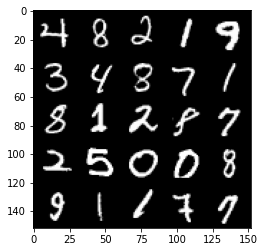

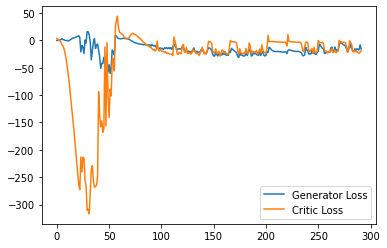

Step 5900: Generator loss: -11.894247283935547, critic loss: -7.789625164985654


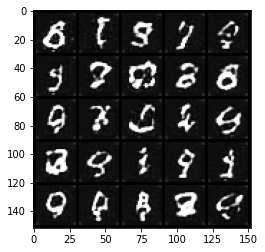

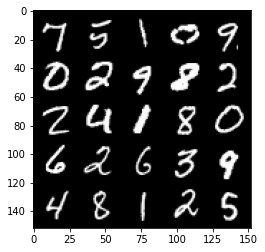

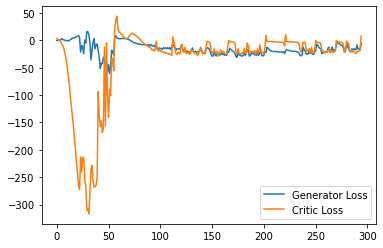

Step 5950: Generator loss: -2.901011128425598, critic loss: -3.3762853469848633


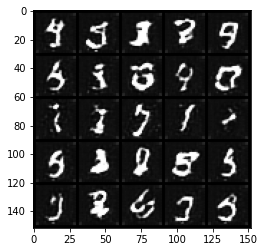

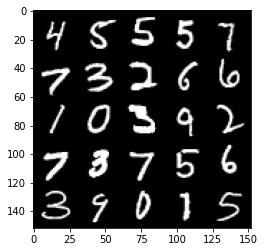

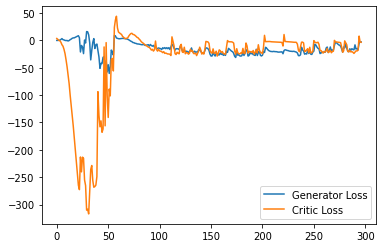

Step 6000: Generator loss: -4.335994229316712, critic loss: -3.8243115253448483


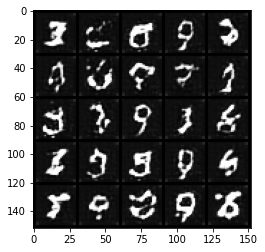

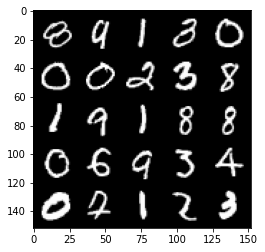

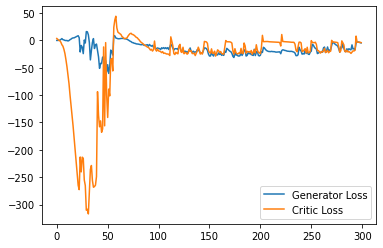

Step 6050: Generator loss: -11.514469265937805, critic loss: -13.140765526294713


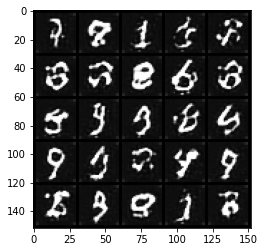

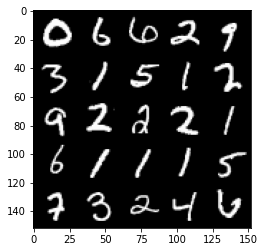

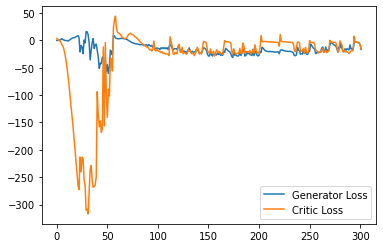

Step 6100: Generator loss: -11.364046477079391, critic loss: -18.96635626602173


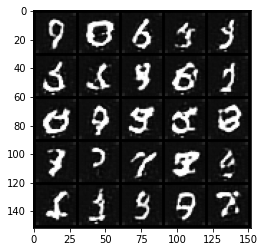

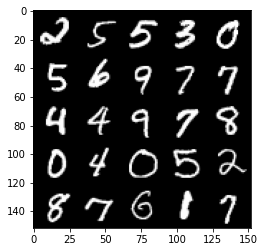

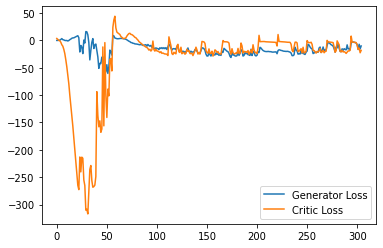

Step 6150: Generator loss: -12.705860614776611, critic loss: -20.393414171934126


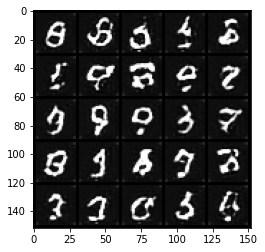

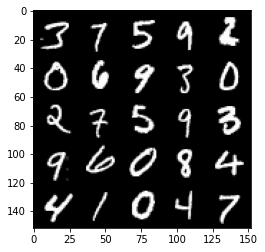

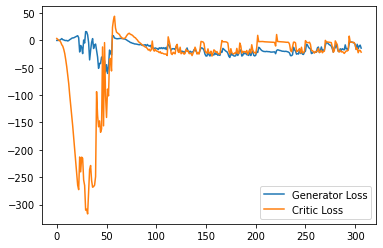

Step 6200: Generator loss: -10.384651122093201, critic loss: -16.7596837553978


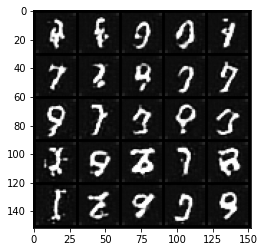

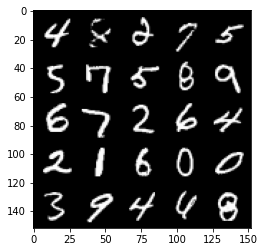

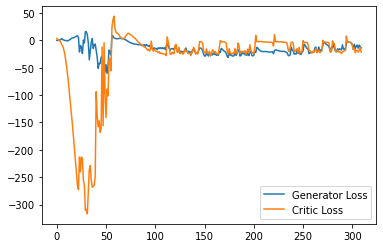

Step 6250: Generator loss: -12.669791678786277, critic loss: -15.057539296150212


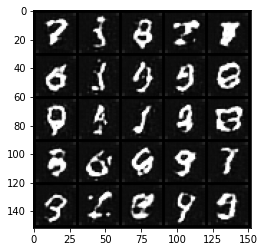

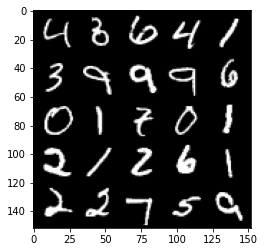

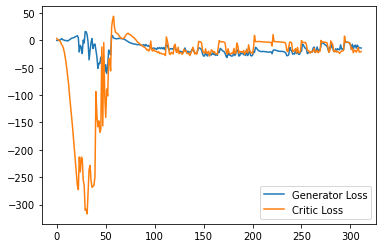

Step 6300: Generator loss: -7.006316699385643, critic loss: -14.277947142601013


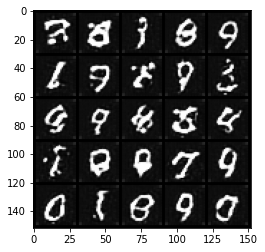

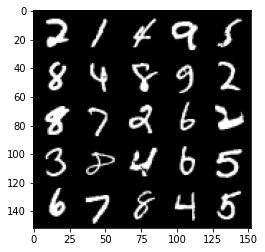

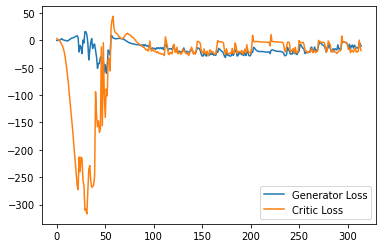

Step 6350: Generator loss: -10.153541693389416, critic loss: -19.67239497280121


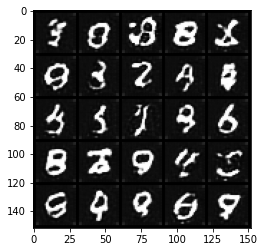

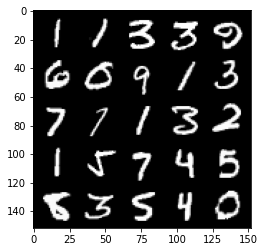

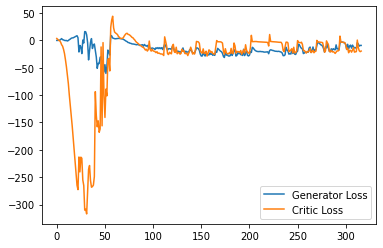

Step 6400: Generator loss: -8.551688634753226, critic loss: -12.30071431875229


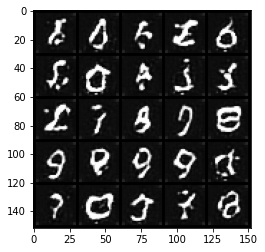

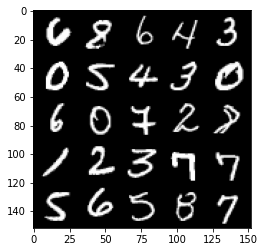

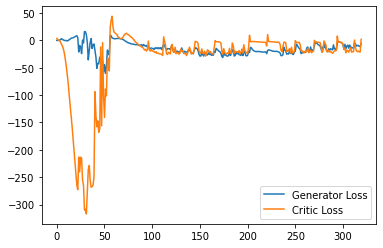

Step 6450: Generator loss: 2.6862664103507994, critic loss: -3.154387630462647


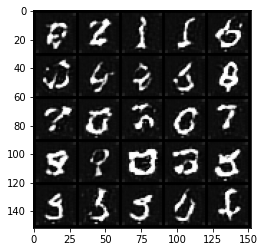

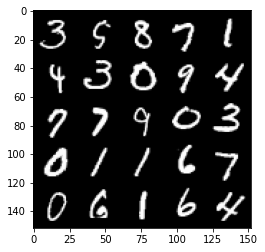

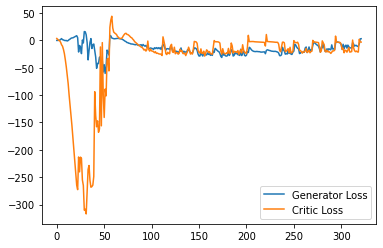

Step 6500: Generator loss: 0.4750145149976015, critic loss: -3.275183390617371


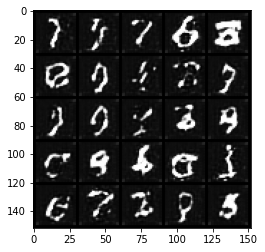

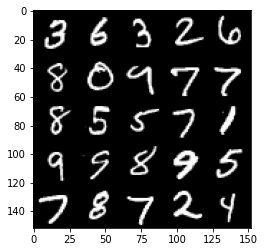

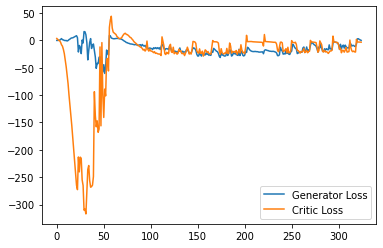

Step 6550: Generator loss: -0.7173165772855282, critic loss: -3.897855875968935


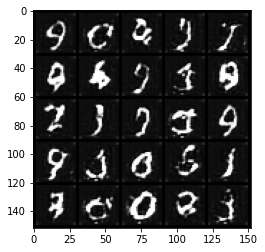

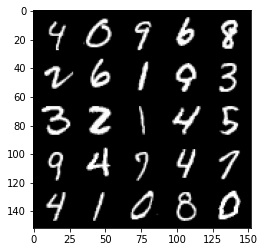

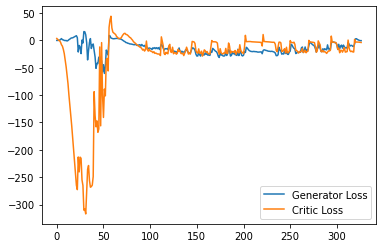

Step 6600: Generator loss: -8.105176895856857, critic loss: -14.255287740707402


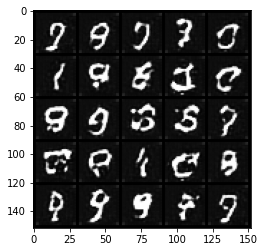

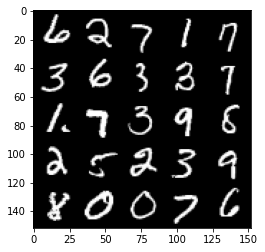

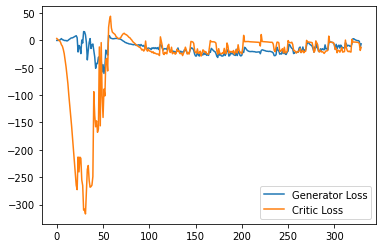

Step 6650: Generator loss: -1.1715032505989074, critic loss: -14.400097558021548


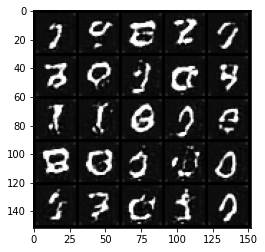

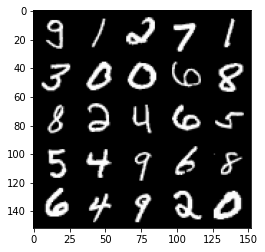

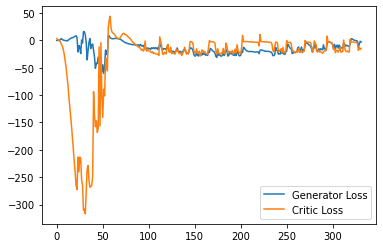

Step 6700: Generator loss: -7.921547185182572, critic loss: -18.161792882919322


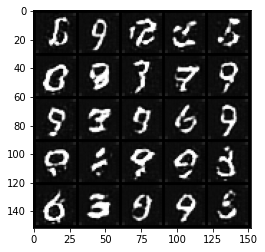

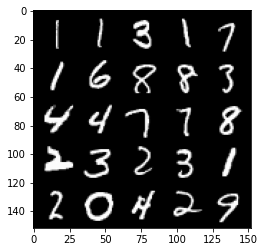

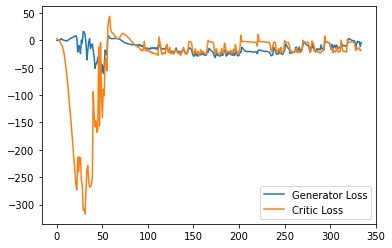

Step 6750: Generator loss: 1.3367904090881348, critic loss: -1.7518291230201735


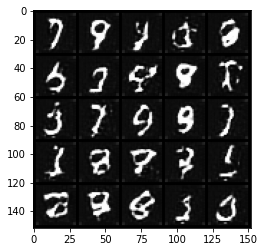

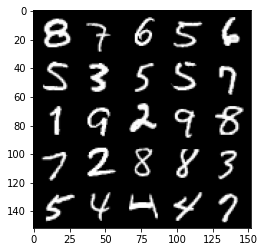

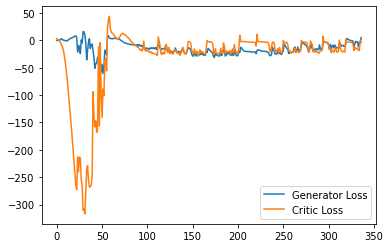

Step 6800: Generator loss: 1.0313433123379945, critic loss: -4.102728202819825


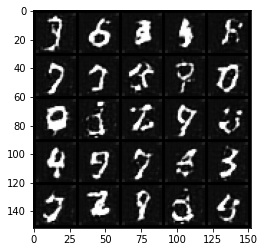

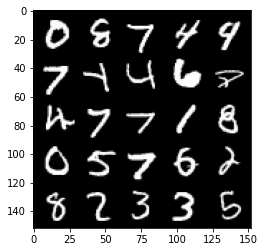

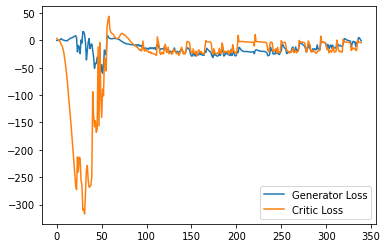

Step 6850: Generator loss: -3.5740674322843553, critic loss: -17.984565327167513


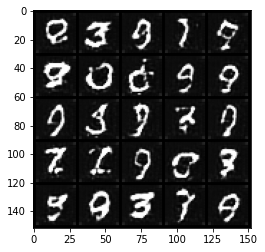

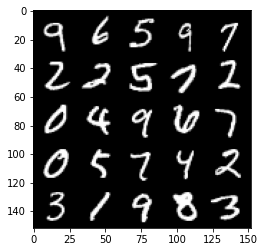

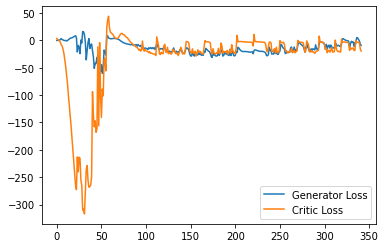

Step 6900: Generator loss: -7.110102490186692, critic loss: -18.283260378360747


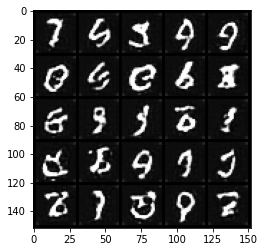

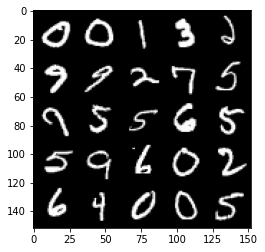

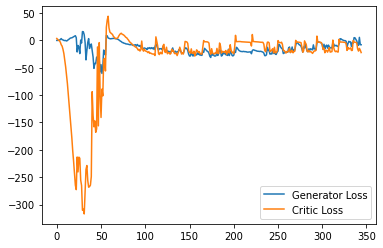

Step 6950: Generator loss: -2.297031201124191, critic loss: -10.292163920402526


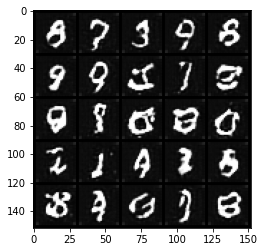

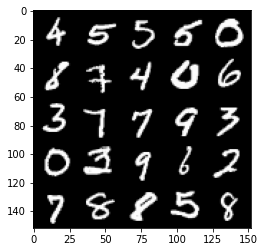

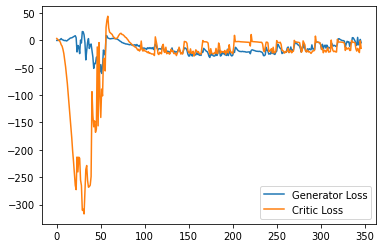

Step 7000: Generator loss: -7.392194065749646, critic loss: -22.382118701934814


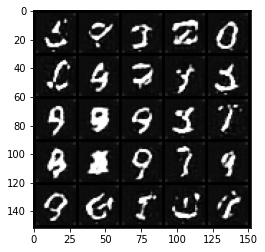

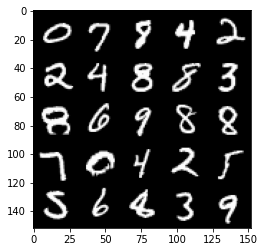

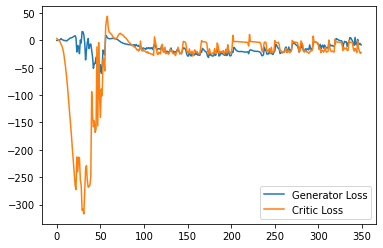

Step 7050: Generator loss: 3.350537167787552, critic loss: -10.752737406253814


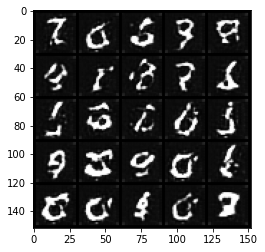

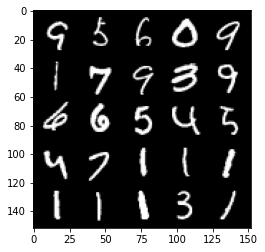

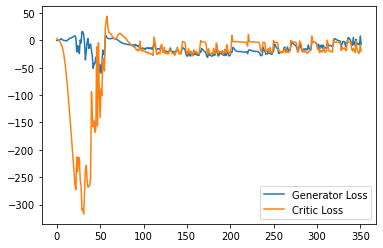

Step 7100: Generator loss: -6.468928385972976, critic loss: -20.58510923957825


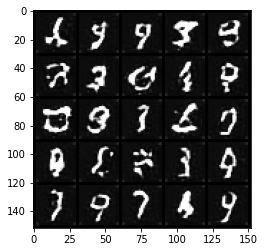

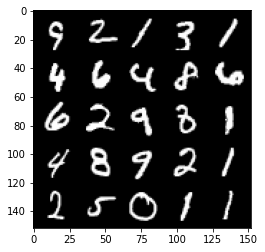

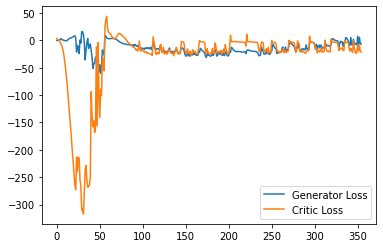

Step 7150: Generator loss: -6.928641391396522, critic loss: -20.497161804676058


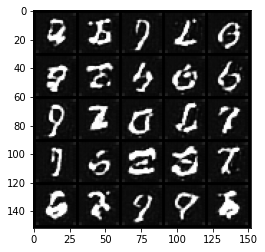

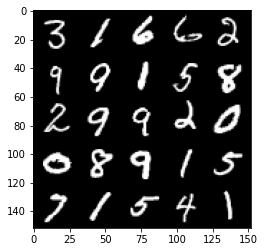

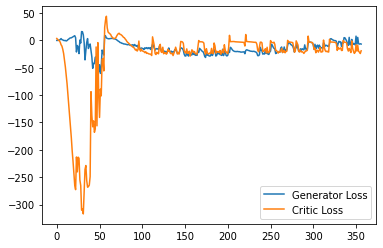

Step 7200: Generator loss: -3.0008954629302025, critic loss: -21.443909392356872


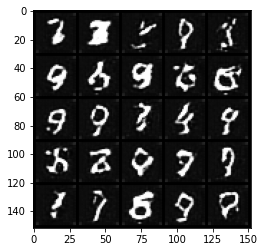

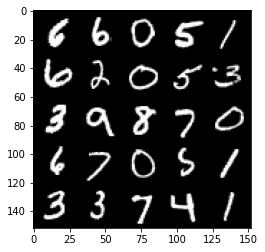

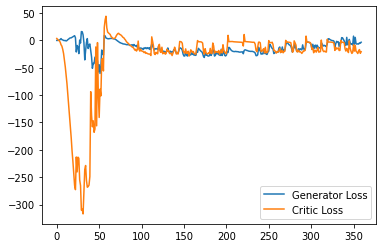

Step 7250: Generator loss: 4.753084670007229, critic loss: -10.598319358110425


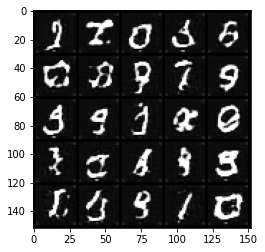

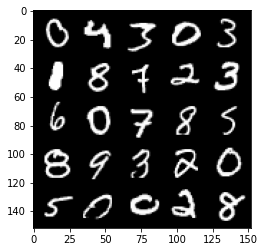

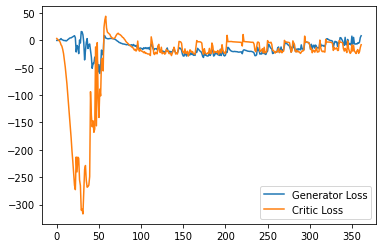

Step 7300: Generator loss: -1.3203195410966873, critic loss: -19.40317055583


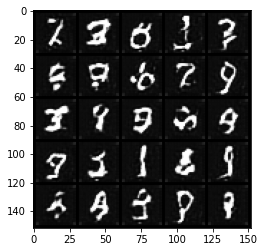

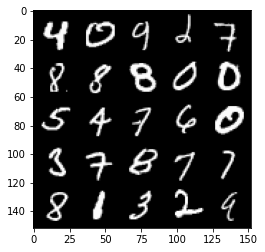

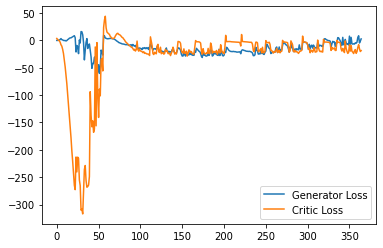

Step 7350: Generator loss: 0.5202344791591167, critic loss: -16.022610904216766


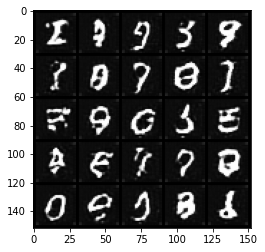

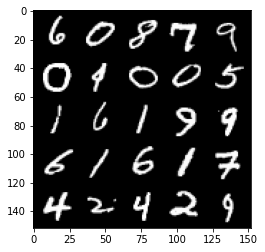

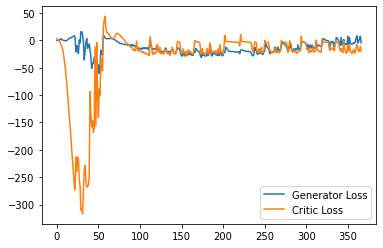

Step 7400: Generator loss: -1.1121525990962982, critic loss: -9.33048616552353


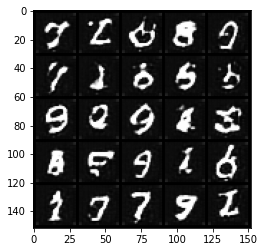

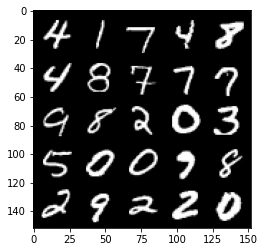

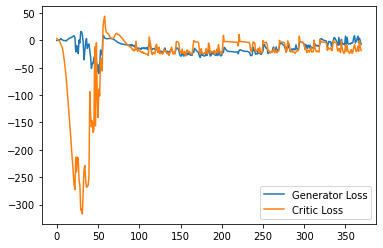

Step 7450: Generator loss: 7.277521052062512, critic loss: -8.269428905487057


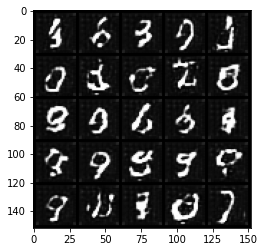

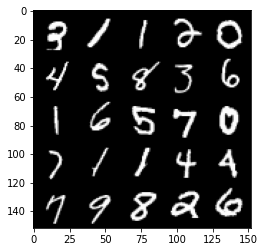

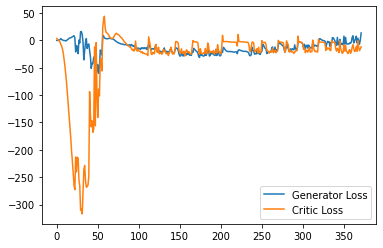

Step 7500: Generator loss: 1.9318218737840653, critic loss: -16.73983634996414


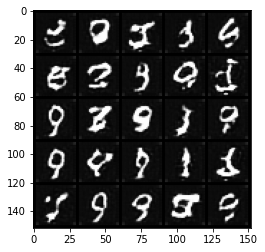

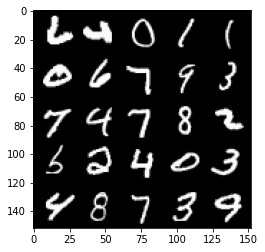

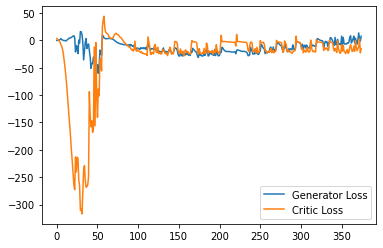

Step 7550: Generator loss: 0.5335738077759743, critic loss: -17.783045617103575


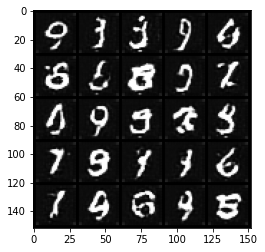

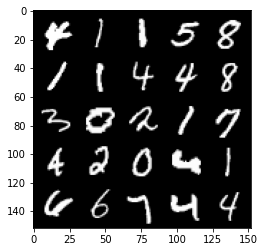

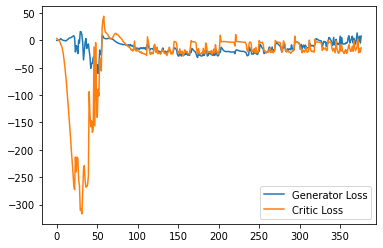

Step 7600: Generator loss: -1.3513446798920632, critic loss: -17.84255580425263


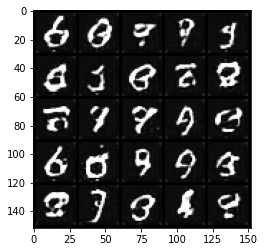

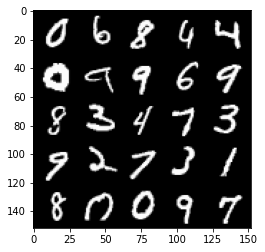

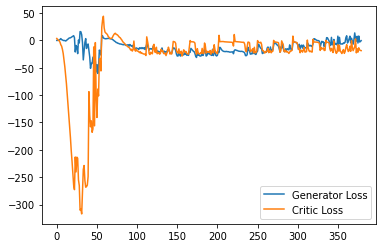

Step 7650: Generator loss: 5.270747475624084, critic loss: -14.592711661815645


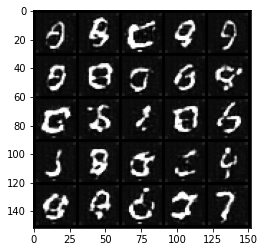

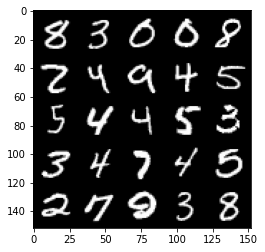

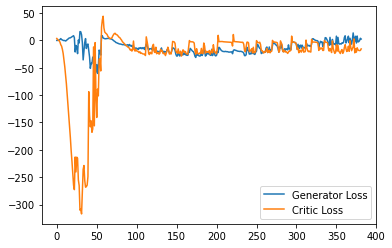

Step 7700: Generator loss: 4.764827686548233, critic loss: -14.75957582426071


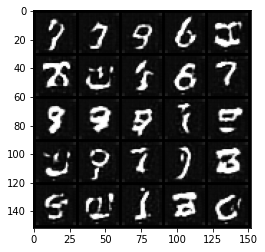

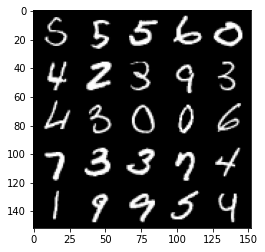

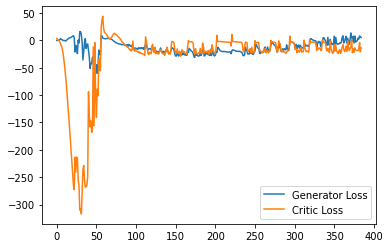

Step 7750: Generator loss: 3.397184783220291, critic loss: -13.720838940620427


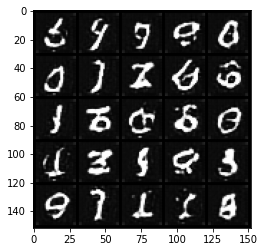

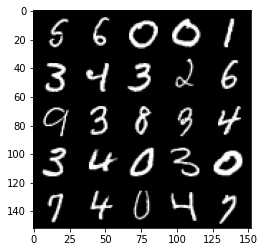

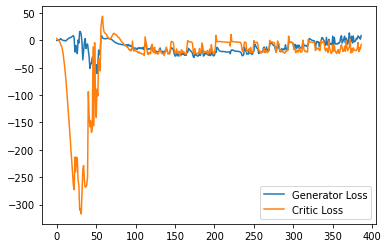

Step 7800: Generator loss: 5.852214518785477, critic loss: -2.3461461131572703


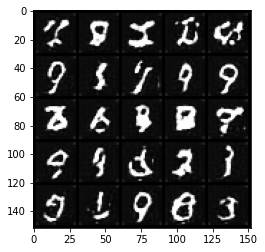

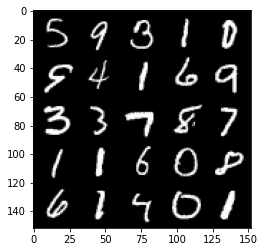

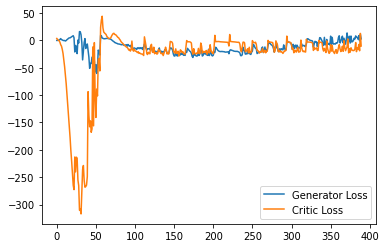

Step 7850: Generator loss: 1.0966358476877212, critic loss: -17.237684150695806


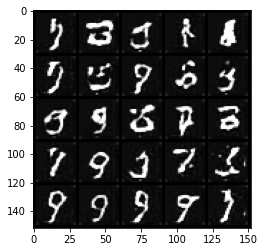

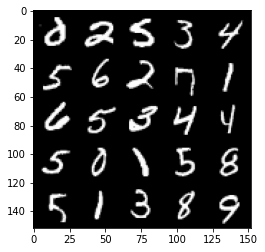

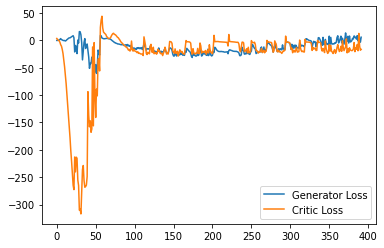

Step 7900: Generator loss: 2.576685194671154, critic loss: -18.784432885885238


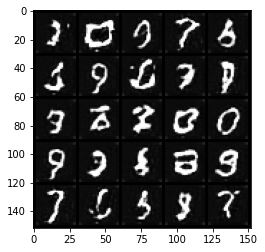

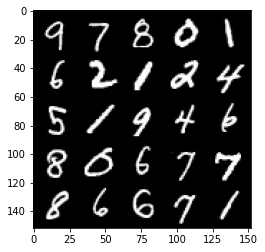

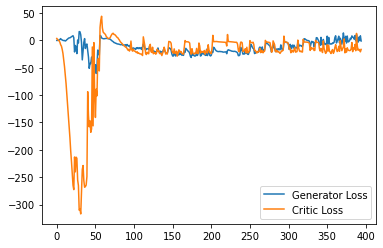

Step 7950: Generator loss: 5.441523186266422, critic loss: -14.745291112422938


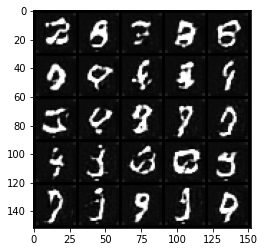

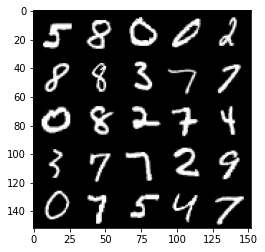

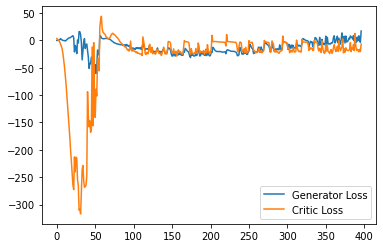

Step 8000: Generator loss: 1.2332842981815337, critic loss: -11.863209961414329


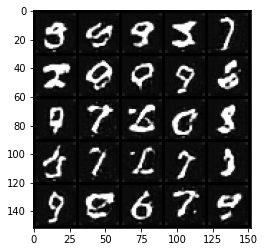

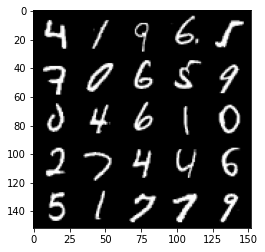

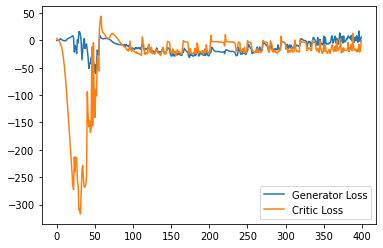

Step 8050: Generator loss: 5.789063376784324, critic loss: -10.480395773410796


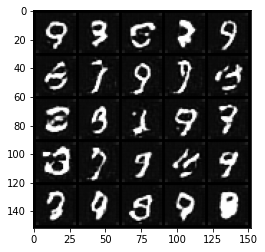

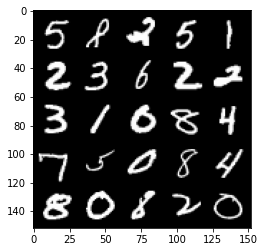

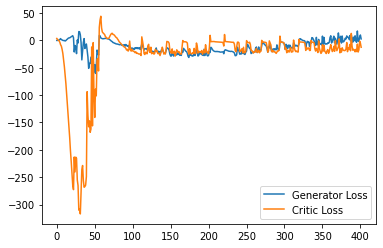

Step 8100: Generator loss: 1.4061349630355835, critic loss: -17.935321774959558


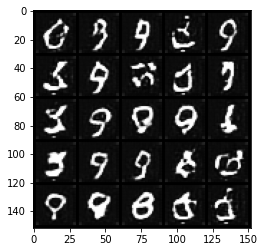

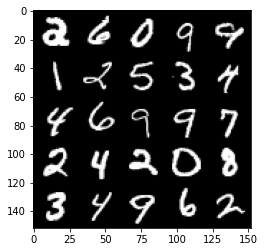

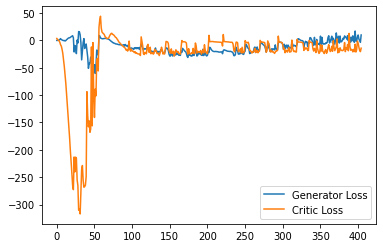

Step 8150: Generator loss: 5.373480933010578, critic loss: -16.1804573225975


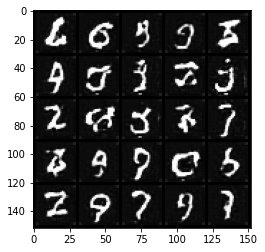

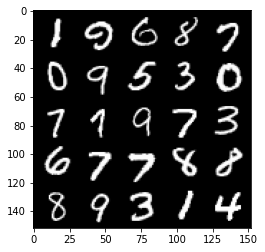

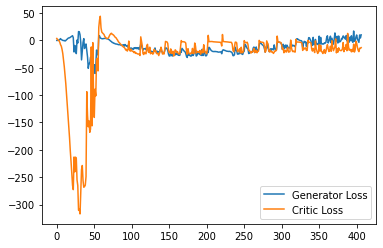

Step 8200: Generator loss: 2.2259988409280775, critic loss: -15.773904715061187


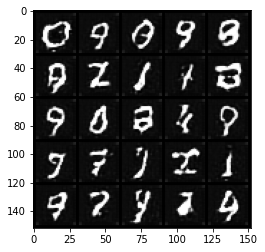

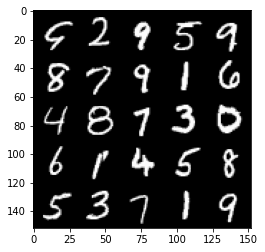

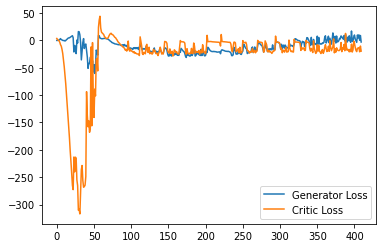

Step 8250: Generator loss: 3.854740139245987, critic loss: -18.884844379186635


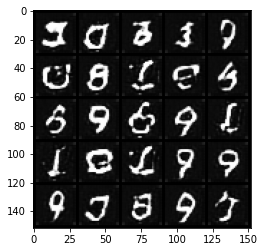

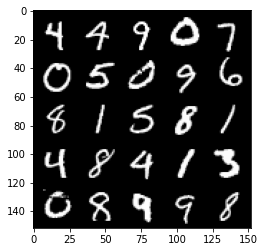

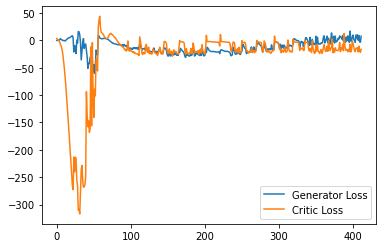

Step 8300: Generator loss: 6.909514579772949, critic loss: -5.586972623586656


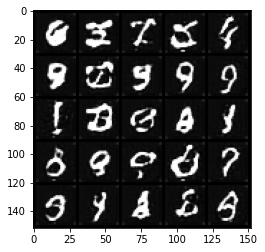

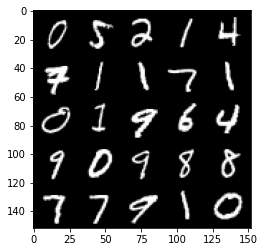

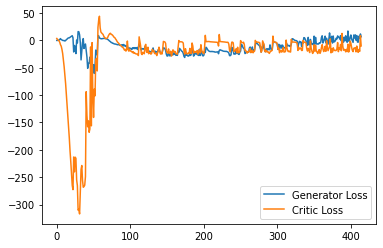

Step 8350: Generator loss: 5.372310450077057, critic loss: -15.130985841274262


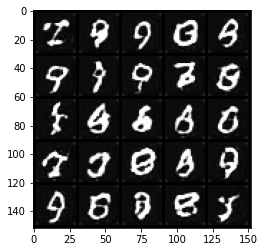

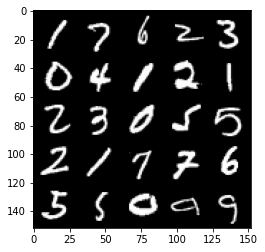

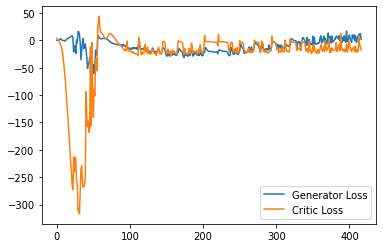

Step 8400: Generator loss: 1.6542006549239159, critic loss: -19.814113160133363


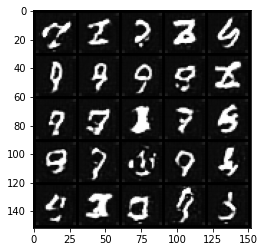

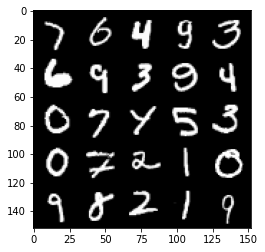

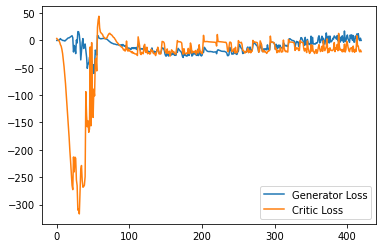

Step 8450: Generator loss: 1.6570431891083717, critic loss: -20.867734878063196


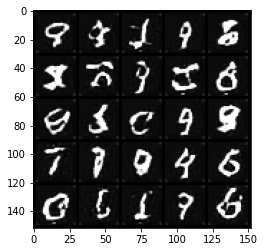

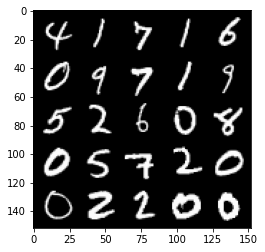

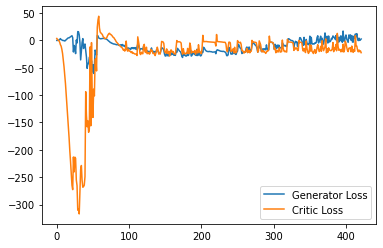

Step 8500: Generator loss: 7.667977865338326, critic loss: -16.47763241434097


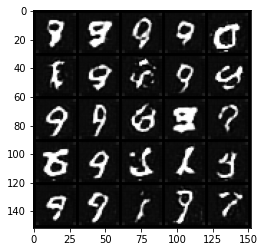

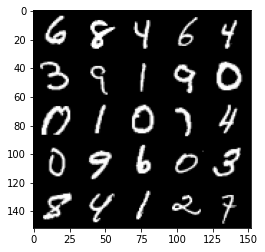

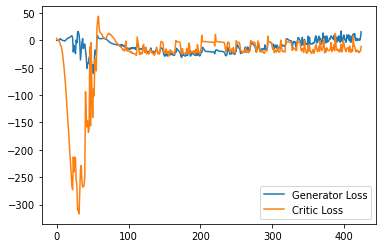

Step 8550: Generator loss: 10.19450773537159, critic loss: -15.78188006973266


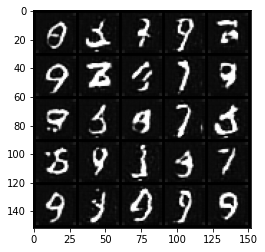

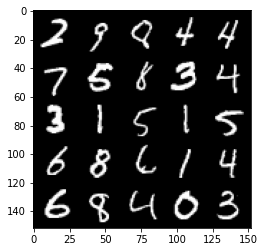

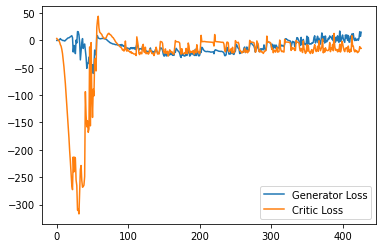

Step 8600: Generator loss: 7.758431231379509, critic loss: -8.763507455706593


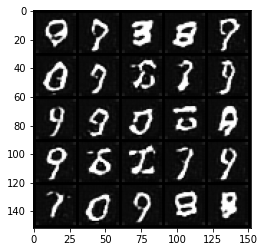

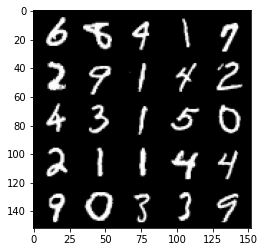

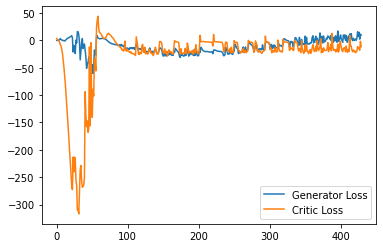

Step 8650: Generator loss: 7.4884306272864345, critic loss: -14.687438910722735


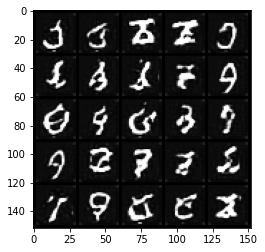

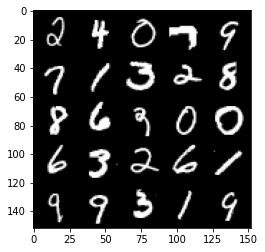

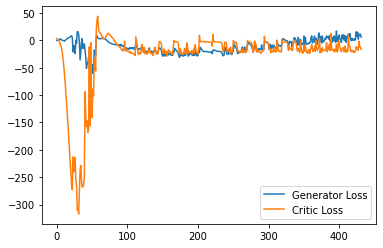

Step 8700: Generator loss: 8.097546907961368, critic loss: -17.20750330781937


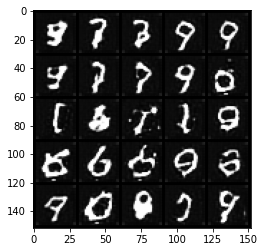

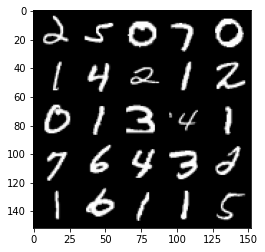

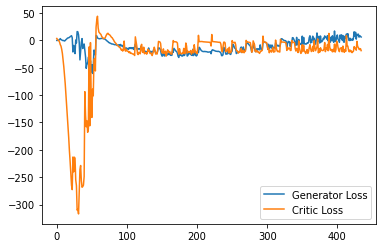

Step 8750: Generator loss: 7.666763976216316, critic loss: -9.916436242103577


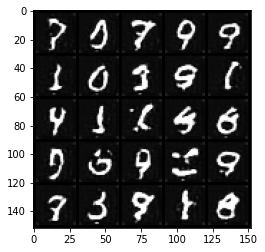

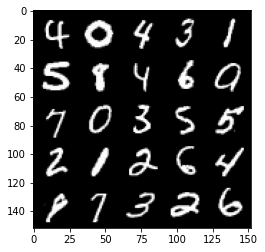

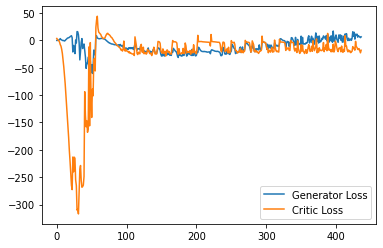

Step 8800: Generator loss: 17.601395111083985, critic loss: -3.681685480117798


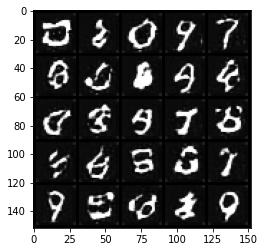

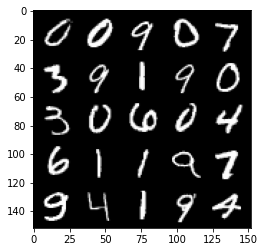

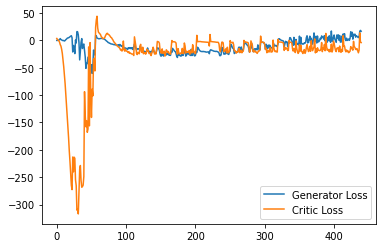

Step 8850: Generator loss: 5.109422425329686, critic loss: -12.743311896324158


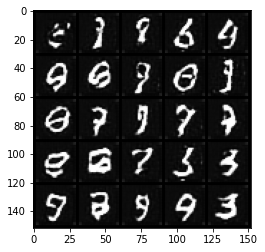

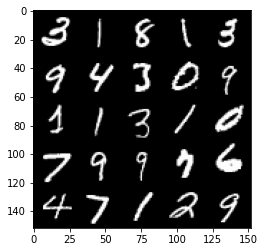

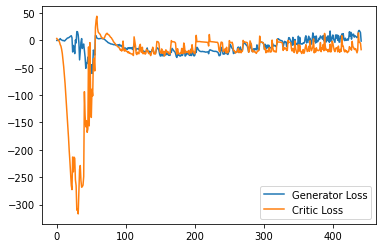

Step 8900: Generator loss: 8.148666616678238, critic loss: -20.78271583795548


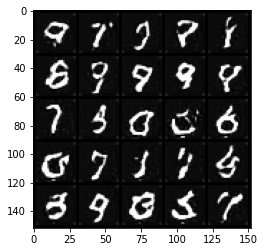

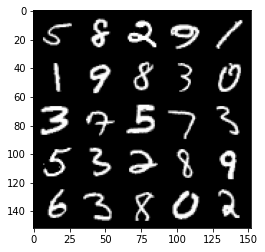

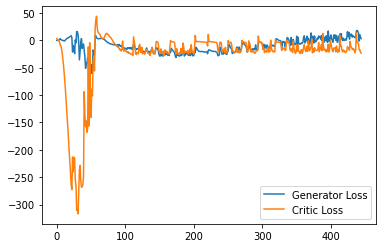

Step 8950: Generator loss: 15.702422853112221, critic loss: -13.570094274044033


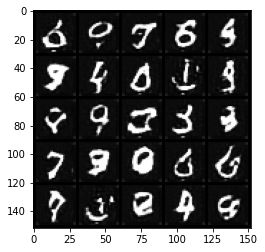

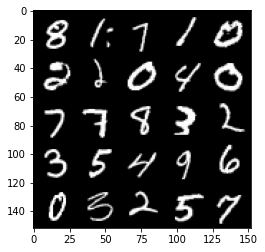

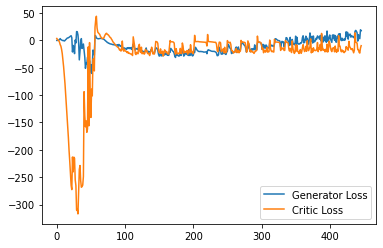

In [ ]:
import matplotlib.pyplot as plt

cur_step = 0
generator_losses = []
critic_losses = []
for epoch in range(n_epochs):
    # Dataloader returns the batches
    for real, _ in tqdm(dataloader):
        cur_batch_size = len(real)
        real = real.to(device)

        mean_iteration_critic_loss = 0
        for _ in range(crit_repeats):
            ### Update critic ###
            crit_opt.zero_grad()
            fake_noise = get_noise(cur_batch_size, z_dim, device=device)
            fake = gen(fake_noise)
            crit_fake_pred = crit(fake.detach())
            crit_real_pred = crit(real)

            epsilon = torch.rand(len(real), 1, 1, 1, device=device, requires_grad=True)
            gradient = get_gradient(crit, real, fake.detach(), epsilon)
            gp = gradient_penalty(gradient)
            crit_loss = get_crit_loss(crit_fake_pred, crit_real_pred, gp, c_lambda)

            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += crit_loss.item() / crit_repeats
            # Update gradients
            crit_loss.backward(retain_graph=True)
            # Update optimizer
            crit_opt.step()
        critic_losses += [mean_iteration_critic_loss]

        ### Update generator ###
        gen_opt.zero_grad()
        fake_noise_2 = get_noise(cur_batch_size, z_dim, device=device)
        fake_2 = gen(fake_noise_2)
        crit_fake_pred = crit(fake_2)
        
        gen_loss = get_gen_loss(crit_fake_pred)
        gen_loss.backward()

        # Update the weights
        gen_opt.step()

        # Keep track of the average generator loss
        generator_losses += [gen_loss.item()]

        ### Visualization code ###
        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            crit_mean = sum(critic_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, critic loss: {crit_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Critic Loss"
            )
            plt.legend()
            plt.show()

        cur_step += 1
